In [1]:
# Import necessary libraries
import matplotlib.pyplot as plt
import numpy as np
import cv2 as cv
import io
from PIL import Image
import glob
import os
import pandas as pd
import matplotlib
matplotlib.style.use('dark_background')
import re
import seaborn as sns
import sys
from datetime import datetime, timedelta
sys.path.append('C:/Seafile/BSc_code/')
from functions import *
import h5py


In [2]:
# Main processing loop for multiple files
pc = 'sophia'
if pc == 'sophia':
    basevol='C:/Seafile/'
    basepath = basevol + '/BSc_data/'
    data_info = basepath + '/data_info/'
    output_folder = basepath + "/processed_data/"
    npz_directory = basepath + 'shark_tracking_data/'
    figures_path = basepath + "figures/"
    mat_file_path = basepath + 'carangids_manual_tracking/tracking/'
else:
    basevol = '/Users/ang/Seafile/'
    basepath = basevol + '/BSc_data/'
    data_info = basepath + '/data_info/'
    output_folder = basepath + "/processed_data/"
    npz_directory = basepath + 'shark_tracking_data/'
    figures_path = basepath + "figures/"
    mat_file_path = basepath + 'carangids_manual_tracking/tracking/'

### define some columns lists

In [3]:
midpoints = [('headx', 'heady'),('midpoint_x', 'midpoint_y'),('btipx', 'btipy'), ('pelvicfinx', 'pelvicfiny'), ('sdfinx', 'sdfiny'), ('pedunclex', 'peduncley'), ('finx','finy'), ('ttipx', 'ttipy')]
midpoints_centered = [('centered_headx', 'centered_heady'),('centered_midpoint_x', 'centered_midpoint_y'),('centered_btipx', 'centered_btipy'), ('centered_pelvicfinx', 'centered_pelvicfiny'), ('centered_sdfinx', 'centered_sdfiny'), ('centered_pedunclex', 'centered_peduncley'), ('centered_finx','centered_finy'), ('centered_ttipx', 'centered_ttipy')]
midpoints_rotated = [('rotated_headx', 'rotated_heady'),('rotated_midpoint_x', 'rotated_midpoint_y'),('rotated_btipx', 'rotated_btipy'), ('rotated_pelvicfinx', 'rotated_pelvicfiny'), ('rotated_sdfinx', 'rotated_sdfiny'), ('rotated_pedunclex', 'rotated_peduncley'), ('rotated_finx','rotated_finy'), ('rotated_ttipx', 'rotated_ttipy')]
joints_to_plot = [f'angle_joint_{i}' for i in range(6)]

In [4]:
file_filters = ["*DJI_0139*","*DJI_0305*","*125_DJI_0266*","*124_DJI_0266*","*DJI_0257*","*DJI_0242*","*DJI_0502*","*DJI_0253*"]

for file_filter in file_filters:
    files_list = np.sort(glob.glob(npz_directory + file_filter))
    
    # Check if files_list is empty
    if not len(files_list):  # or simply: if not files_list
        print(f"No files found for {file_filter}")
        continue

    filename_with_extension = os.path.basename(files_list[0])
    filename = os.path.splitext(filename_with_extension)[0]
    base_filename = filename.rsplit('_', 1)[0]
    break

### Read shark data

In [5]:
sharks_df = pd.read_hdf(output_folder + "subset_sharks.h5", key='sharks')

In [6]:
sharks_df.head()

,index,SPEED#wcentroid,ID,X#pcentroid,Y#pcentroid,ANGLE,frame,time,headx,heady,...,Y,segment,Trial,tracklet,midpoint_x,midpoint_y,carangids,drone_movement,ID_checked,unique_id_count
0,2051,82.591229,0,610.453339,-395.657349,-0.474050,2051,40.95,3176.000,1068.625,...,-395.657349,1.0,sequence_20240306_161443984_DJI_0139,1.0,3151.3750,1083.3125,1,0,1.0,2.0
1,2052,76.377851,0,612.260132,-395.038773,-0.498781,2052,40.97,3177.500,1068.000,...,-395.038773,1.0,sequence_20240306_161443984_DJI_0139,1.0,3153.0625,1083.3125,1,0,1.0,2.0
2,2053,76.368695,0,614.038269,-394.407806,-0.523343,2053,40.99,3179.000,1067.375,...,-394.407806,1.0,sequence_20240306_161443984_DJI_0139,1.0,3154.8125,1083.3125,1,0,1.0,2.0
3,2054,82.665998,0,615.772919,-393.922348,-0.542446,2054,41.01,3180.500,1066.875,...,-393.922348,1.0,sequence_20240306_161443984_DJI_0139,1.0,3156.5625,1083.3125,1,0,1.0,2.0
4,2055,84.058618,0,617.394592,-393.320221,-0.562341,2055,41.03,3181.875,1066.500,...,-393.320221,1.0,sequence_20240306_161443984_DJI_0139,1.0,3158.2500,1083.4375,1,0,1.0,2.0


In [7]:

# Function to calculate the heading based on head and btip positions
# Function to calculate heading and angular velocity
def calculate_heading_and_angular_velocity(df, fps):
    """
    Calculate the heading angle and angular velocity based on headx, heady, and btipx, btipy.
    
    Heading is calculated as the arctangent of the slope formed by the line
    between the points (headx, heady) and (btipx, btipy).
    
    Angular velocity is calculated as the change in heading over time.

    Parameters:
    df (DataFrame): A pandas DataFrame that contains columns headx, heady, btipx, btipy.
    fps (int): Frames per second to calculate delta time (default is 30 FPS).
    
    Returns:
    DataFrame: The original DataFrame with new 'heading' and 'angular_velocity' columns.
    """
    # Calculate dx and dy for heading
    dx = df['headx'] - df['midpoint_x']
    dy = df['heady'] - df['midpoint_y']
    
    # Calculate heading in radians
    heading_radians = np.arctan2(dy, dx)
    
    # Add heading to the dataframe
    df['heading'] = heading_radians
    
    # Calculate delta heading (change in heading between consecutive points)
    df['delta_heading'] = df['heading'].diff()
    
    # Normalize delta_heading to handle wraparound (i.e., from -π to π)
    df['delta_heading'] = (df['delta_heading'] + np.pi) % (2 * np.pi) - np.pi
    
    # Calculate delta time (time between consecutive frames)
    df['delta_time'] = 1 / fps  # Assuming constant FPS
    
    # Calculate angular velocity (change in heading / delta time)
    df['angular_velocity'] = df['delta_heading'] / df['delta_time']
    
    # Drop intermediate columns (optional)
    df.drop(columns=['delta_time', 'delta_heading'], inplace=True)
    
    return df

# Function to calculate heading and angular velocity for each unique ID and segment
def calculate_heading_and_angular_velocity_per_id_segment(df, fps):
    """
    Calculate heading and angular velocity for each unique ID and segment.

    Parameters:
    df (DataFrame): A pandas DataFrame that contains columns headx, heady, btipx, btipy, ID, and segment.
    fps (int): Frames per second to calculate delta time.
    
    Returns:
    DataFrame: The original DataFrame with new 'heading' and 'angular_velocity' columns.
    """
    # Apply the heading and angular velocity calculation for each ID and segment
    df = df.groupby(['ID', 'segment', 'Trial']).apply(calculate_heading_and_angular_velocity, fps=fps).reset_index(drop=True)
    
    return df

def calculate_speed_with_step(df, colx, coly, fps, step_size, max_speed=500000, max_acceleration=500000):
    """
    Calculate speed with a step size.

    Parameters:
    - df: DataFrame containing the position and frame data.
    - colx: Column name for the x-coordinate.
    - coly: Column name for the y-coordinate.
    - fps: Frames per second of the data.
    - step_size: Number of frames to skip for position differences.
    - max_speed: Maximum allowed speed for filtering outliers.

    Returns:
    - DataFrame with a new 'speed' column added.
    """
    # Calculate step differences
    df['delta_time'] = (df['frame'].diff(periods=step_size)) / fps
    df['delta_x'] = df[colx].diff(periods=step_size)
    df['delta_y'] = df[coly].diff(periods=step_size)
    
    # Calculate speed
    df['speed'] = np.sqrt(df['delta_x']**2 + df['delta_y']**2) / df['delta_time']
    
    # Apply filter to avoid unrealistically high speeds
    df.loc[df['speed'] > max_speed, 'speed'] = np.nan
    
    # Drop intermediate columns
    df.drop(columns=['delta_x', 'delta_y'], inplace=True)
    
    return df
    
# Function to calculate the heading for each unique ID and segment
def calculate_speed_per_id_segment(df, colx,coly,fps, step_size, max_speed=500000, max_acceleration=500000):
    """
    Calculate the heading angle based on headx, heady and btipx, btipy for each unique ID and segment.

    Parameters:
    df (DataFrame): A pandas DataFrame that contains columns headx, heady, btipx, btipy, ID, and segment.

    Returns:
    DataFrame: The original DataFrame with a new 'heading' column.
    """
    df = df.groupby(['ID', 'segment','Trial']).apply(calculate_speed_with_step,colx,coly,fps, step_size, max_speed=500000, max_acceleration=500000).reset_index(drop=True)
    return df

# Function to rotate a point based on the angle
def rotate_point(x, y, angle_rad):
    cos_theta = np.cos(-angle_rad)  # Negative for counter-clockwise rotation
    sin_theta = np.sin(-angle_rad)
    x_rot = cos_theta * x - sin_theta * y
    y_rot = sin_theta * x + cos_theta * y
    return x_rot, y_rot

# Function to center the points and normalize by the heading for each ID and segment
def center_and_rotate(df,midpoints):
    # Step 1: Calculate the midpoint between the head and btip for each frame

    # List of raw midline points
    # midline_raw_points = [
    #     ('headx', 'heady'), ('btipx', 'btipy'), ('pelvicfinx', 'pelvicfiny'),
    #     ('sdfinx', 'sdfiny'), ('pedunclex', 'peduncley'), ('finx', 'finy'), ('ttipx', 'ttipy')
    # ]

    # Step 2: Center all points by subtracting the midpoint
    for (x_col, y_col) in midpoints:
        df[f'centered_{x_col}'] = df[x_col] - df['midpoint_x']
        df[f'centered_{y_col}'] = df[y_col] - df['midpoint_y']

    # Step 3: Rotate all centered points based on the heading angle
    for (x_col, y_col) in midpoints:
        df[f'rotated_{x_col}'], df[f'rotated_{y_col}'] = zip(
            *df.apply(lambda row: rotate_point(
                row[f'centered_{x_col}'], row[f'centered_{y_col}'], row['heading']), axis=1)
        )

    return df

# Function to center and rotate per ID and segment
def center_and_rotate_per_id_segment(df,midpoints):
    """
    Apply centering and rotating per unique ID and segment.
    
    Parameters:
    df (DataFrame): A pandas DataFrame that contains columns headx, heady, btipx, btipy, ID, and segment.

    Returns:
    DataFrame: The original DataFrame with normalized and rotated points.
    """
    df = df.groupby(['ID', 'segment','Trial']).apply(center_and_rotate,midpoints).reset_index(drop=True)
    return df

# Load your data
# data = pd.read_csv('your_data.csv')  # Replace with your actual file path


# Function to calculate angles between consecutive points in the skeleton
def skeletons_to_angles(skeleton):
    '''skeleton: array(nframes, 2)'''
    skelX = skeleton[:, 0]
    skelY = skeleton[:, 1]
    dX = np.diff(skelX, axis=0)
    dY = np.diff(skelY, axis=0)
    
    # Calculate tangent angles. atan2 uses angles from -pi to pi
    angles = np.arctan2(dY, dX)
    angles = np.mod(angles,np.pi)
    return angles

# Function to calculate angles and add them to a DataFrame for each frame
def calculate_angles_for_df(df,midpoints_centered):
    """
    Calculate angles for the rotated skeleton points in the DataFrame.

    Parameters:
    df (DataFrame): A pandas DataFrame containing rotated skeleton points.

    Returns:
    DataFrame: The original DataFrame with additional columns for angles between joints.
    """
    # # Define the rotated points (must be in the correct order)
    # midline_rotated_points = [
    #     ('rotated_headx', 'rotated_heady'), ('rotated_btipx', 'rotated_btipy'),
    #     ('rotated_pelvicfinx', 'rotated_pelvicfiny'), ('rotated_sdfinx', 'rotated_sdfiny'),
    #     ('rotated_pedunclex', 'rotated_peduncley'), ('rotated_finx', 'rotated_finy'),
    #     ('rotated_ttipx', 'rotated_ttipy')
    # ]
    
    # Prepare for storing angles
    angles_list = []

    # Loop over each frame in the dataframe
    for idx, row in df.iterrows():
        # Extract the rotated x and y points for the current frame
        skeleton = np.array([[row[x_col], row[y_col]] for (x_col, y_col) in midpoints_centered])
        # Calculate angles for the current skeleton
        angles = skeletons_to_angles(skeleton)
        
        # Store the angles
        angles_list.append(angles)
    
    # Convert list of angles to a DataFrame
    angles_df = pd.DataFrame(
        angles_list,
        columns=[
            f"angle_joint_{i}" for i in range(len(midpoints_centered) - 1)
        ]
    )
    
    # Concatenate the angles DataFrame with the original dataframe
    df = pd.concat([df, angles_df], axis=1)
    
    return df

# # Function to center, rotate, and calculate angles for each ID and segment
# def center_rotate_and_calculate_angles_per_id_segment(df,midpoints):
#     """
#     Apply centering, rotating, and angle calculation per unique ID and segment.
    
#     Parameters:
#     df (DataFrame): A pandas DataFrame that contains columns headx, heady, btipx, btipy, ID, and segment.

#     Returns:
#     DataFrame: The original DataFrame with normalized, rotated points and angle columns.
#     """
#     # Step 1: Apply centering and rotation
#     df = center_and_rotate_per_id_segment(df,midpoints)
        
    
#     return df





### Filter for segment duration

In [13]:
# Group by both 'ID' and 'segment' and count the number of frames for each group
id_segment_counts = sharks_df.groupby(['ID', 'segment','Trial']).size()

# Filter out ID-segment combinations that have less than 100 frames (2 seconds)
id_segments_to_keep = id_segment_counts[id_segment_counts >= 100].index

# Keep only the rows where the combination of 'ID' and 'segment' is in the list of groups with >= 100 frames
df_filtered = sharks_df[sharks_df.set_index(['ID', 'segment','Trial']).index.isin(id_segments_to_keep)]

In [9]:
df_filtered = df_filtered[(df_filtered['ID_checked'] == 1) & (df_filtered['drone_movement'] == 0)]

In [8]:
# Step 1: Group by both 'ID' and 'segment' and count the total number of rows and number of NaNs
grouped = sharks_df.groupby(['ID', 'segment','Trial'])

# Count the total rows and the number of NaN values per group
total_rows_per_group = grouped.size()
nans_per_group = grouped.apply(lambda x: x.isna().sum().sum(),include_groups=False)  # Total NaNs across all columns per group

# Step 2: Calculate the percentage of NaNs for each group
nan_percentage_per_group = nans_per_group / (total_rows_per_group * sharks_df.shape[1])

# Step 3: Filter out groups with more than 50% NaNs
groups_to_keep = nan_percentage_per_group[nan_percentage_per_group <= 0.5].index

# Step 4: Keep only the rows where the combination of 'ID' and 'segment' is in the list of valid groups
df_sharks_filt = sharks_df[sharks_df.set_index(['ID', 'segment','Trial']).index.isin(groups_to_keep)]
sharks_output_file = os.path.join(output_folder, f"{base_filename}_sharks_filtered.h5")
df_sharks_filt.to_hdf(sharks_output_file, key='sharks_filtered', mode='w')


In [9]:
# Step 3: Apply the heading calculation, centering, rotation, and angle calculation
data = calculate_heading_and_angular_velocity_per_id_segment(df_sharks_filt, fps = 50)


C:\Users\sophi\AppData\Local\Temp\ipykernel_14220\2443526695.py:59: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby(['ID', 'segment', 'Trial']).apply(calculate_heading_and_angular_velocity, fps=fps).reset_index(drop=True)


In [12]:
data3=calculate_speed_per_id_segment(df_sharks_filt)

TypeError: calculate_speed_per_id_segment() missing 4 required positional arguments: 'colx', 'coly', 'fps', and 'step_size'

In [10]:
data2 = center_and_rotate_per_id_segment(data,midpoints)

C:\Users\sophi\AppData\Local\Temp\ipykernel_14220\2443526695.py:151: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby(['ID', 'segment','Trial']).apply(center_and_rotate,midpoints).reset_index(drop=True)


In [11]:
data.groupby('ID').count()

,index,SPEED#wcentroid,X#pcentroid,Y#pcentroid,ANGLE,frame,time,headx,heady,lxfinx,...,Trial,tracklet,midpoint_x,midpoint_y,carangids,drone_movement,ID_checked,unique_id_count,heading,angular_velocity
ID,,,,,,,,,,,,,,,,,,,,,
0,307326,307326,132511,132511,215789,307326,307326,307326,307326,307326,...,307326,307326,307326,307326,307326,307326,307326,307324,307326,307253
1,272934,272934,158478,158478,213570,272934,272934,272934,272934,272934,...,272934,272934,272934,272934,272934,272934,272934,272934,272934,272850
2,119473,119473,80706,80706,93228,119473,119473,119473,119473,119473,...,119473,119473,119473,119473,119473,119473,119473,119473,119473,119438
3,78101,78101,45104,45104,58871,78101,78101,78098,78098,78101,...,78101,78101,78101,78101,78101,78101,78101,78101,78098,78074
4,13168,13168,0,0,13168,13168,13168,13168,13168,13168,...,13168,13168,13168,13168,13168,13168,13168,13168,13168,13160
5,16045,16045,0,0,16045,16045,16045,16045,16045,16045,...,16045,16045,16045,16045,16045,16045,16045,16045,16045,16036


In [12]:
data2.groupby('ID').count()

,index,SPEED#wcentroid,X#pcentroid,Y#pcentroid,ANGLE,frame,time,headx,heady,lxfinx,...,rotated_pelvicfinx,rotated_pelvicfiny,rotated_sdfinx,rotated_sdfiny,rotated_pedunclex,rotated_peduncley,rotated_finx,rotated_finy,rotated_ttipx,rotated_ttipy
ID,,,,,,,,,,,,,,,,,,,,,
0,307326,307326,132511,132511,215789,307326,307326,307326,307326,307326,...,307326,307326,307324,307324,307324,307324,307324,307324,307324,307324
1,272934,272934,158478,158478,213570,272934,272934,272934,272934,272934,...,272934,272934,272922,272922,272920,272920,272920,272920,272920,272920
2,119473,119473,80706,80706,93228,119473,119473,119473,119473,119473,...,119473,119473,119473,119473,119473,119473,119473,119473,119473,119473
3,78101,78101,45104,45104,58871,78101,78101,78098,78098,78101,...,78098,78098,78098,78098,78098,78098,78097,78097,78098,78098
4,13168,13168,0,0,13168,13168,13168,13168,13168,13168,...,13168,13168,13168,13168,13168,13168,13168,13168,13168,13168
5,16045,16045,0,0,16045,16045,16045,16045,16045,16045,...,16045,16045,16045,16045,16045,16045,16045,16045,16045,16045


In [13]:
# Save sharks_df to HDF5
sharks_output_file = os.path.join(output_folder, "data2_sharks.h5")
data2.to_hdf(sharks_output_file, key='sharks', mode='w')
print(f"Shark data saved to {sharks_output_file}")

Shark data saved to C:/Seafile//BSc_data//processed_data/data2_sharks.h5


In [14]:
# Save sharks_df to HDF5
sharks_output_file = os.path.join(output_folder, "heading_sharks.h5")
data.to_hdf(sharks_output_file, key='sharks', mode='w')
print(f"Shark data saved to {sharks_output_file}")

Shark data saved to C:/Seafile//BSc_data//processed_data/heading_sharks.h5


#### Graphs

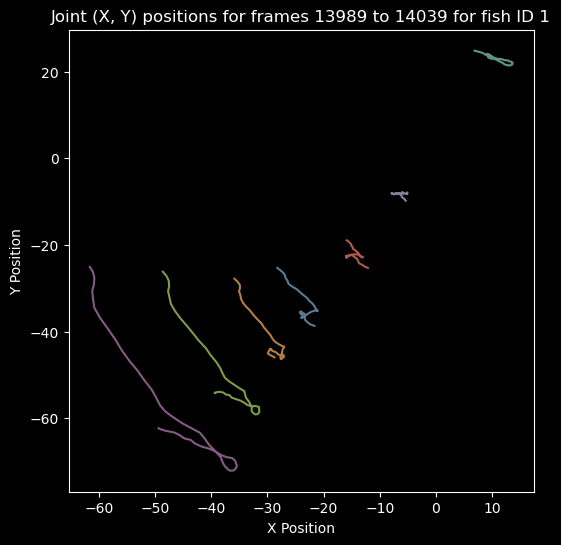

In [15]:

# Define variables for fish ID and frame range
fish_id = 1  
trial = 'sequence_20240305_164039273_DJI_0305'  


# Filter data for the specific fish ID
onefish = data2[(data2['ID'] == fish_id) & (data2['Trial'] == trial)]

nframes = 50
frame_start = np.random.choice(onefish.frame.unique())
frame_end = frame_start + nframes

# Ensure joints_to_plot has an even number of elements
if len(joints_to_plot) % 2 != 0:
    joints_to_plot = joints_to_plot[:-1]  # Remove the last element if the list length is odd

onefish_in_frames = onefish[onefish['frame'].between(frame_start, frame_end)]


# Identify all angle columns
joints_to_plot = [
    col for col in onefish.columns
    if col.startswith('centered_') and col != 'centered_midpoint_'
]

# Group joints into (x, y) pairs
joint_pairs = [(joints_to_plot[i], joints_to_plot[i+1]) for i in range(0, len(joints_to_plot), 2)]

# Initialize the plot
plt.figure(figsize=(6, 6))

# Plot each joint (x, y) pair
for x_key, y_key in joint_pairs:
    plt.plot(
        onefish_in_frames[x_key], 
        onefish_in_frames[y_key], 
        label=f'{x_key} vs {y_key}', 
        alpha=0.7
    )

# Customize the plot
plt.xlabel('X Position')
plt.ylabel('Y Position')
plt.title(f'Joint (X, Y) positions for frames {frame_start} to {frame_end} for fish ID {fish_id}')
# plt.legend(loc='upper right', bbox_to_anchor=(1.15, 1))
plt.show()


In [16]:
# Define variables for fish ID and frame range
fish_id = 2 
trial = 'sequence_20240305_164039273_DJI_0305'  

# Filter data for the specific fish ID
onefish = data2[(data2['ID'] == fish_id) & (data2['Trial'] == trial)]

(-80.0, 80.0)

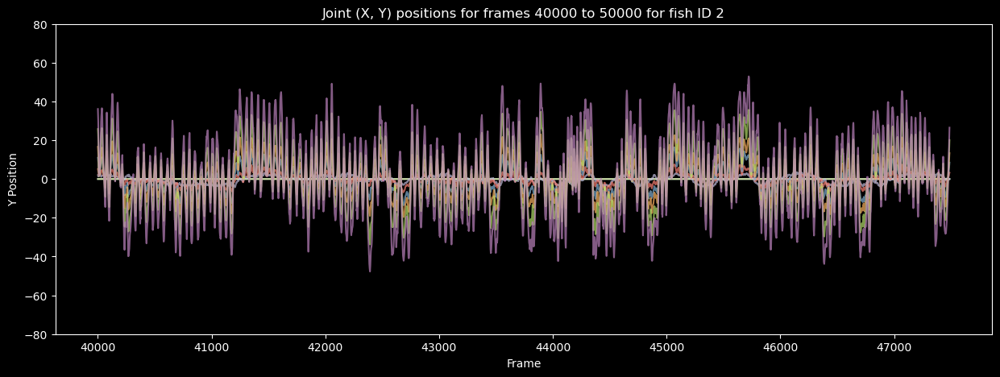

In [17]:
frame_start = 40000
frame_end = 50000
#nframes = 100
#frame_start = np.random.choice(onefish.frame.unique())
#frame_end = frame_start + nframes

# Ensure joints_to_plot has an even number of elements
if len(joints_to_plot) % 2 != 0:
    joints_to_plot = joints_to_plot[:-1]  # Remove the last element if the list length is odd

onefish_in_frames = onefish[onefish['frame'].between(frame_start, frame_end)]

# Identify all angle columns
joints_to_plot = [
    col for col in onefish.columns
    if col.startswith('rotated_') and col != 'rotated_midpoint_'
]

# Group joints into (x, y) pairs
joint_pairs = [(joints_to_plot[i], joints_to_plot[i+1]) for i in range(0, len(joints_to_plot), 2)]

# Initialize the plot
plt.figure(figsize=(15, 5))

# Plot each joint (x, y) pair
for x_key, y_key in joint_pairs:
    plt.plot(
        onefish_in_frames['frame'], 
        onefish_in_frames[y_key], 
        label=f'{x_key} vs {y_key}', 
        alpha=0.7
    )

# Customize the plot
plt.xlabel('Frame')
plt.ylabel('Y Position')
plt.title(f'Joint (X, Y) positions for frames {frame_start} to {frame_end} for fish ID {fish_id}')
# plt.legend(loc='upper right', bbox_to_anchor=(1.15, 1))
plt.ylim([-80,80])

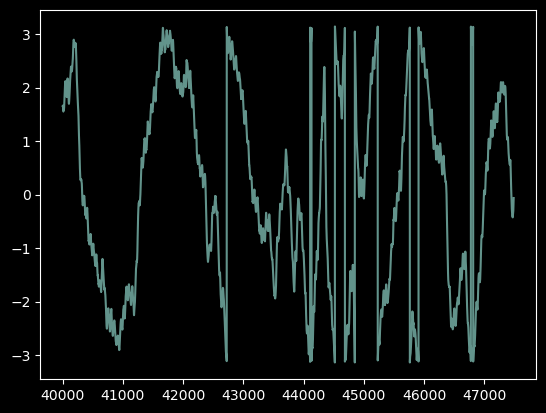

In [18]:
# Plot each joint (x, y) pair
plt.plot(
    onefish_in_frames['frame'], 
    onefish_in_frames['heading'], 
    # label=f'{x_key} vs {y_key}', 
    alpha=0.7
)

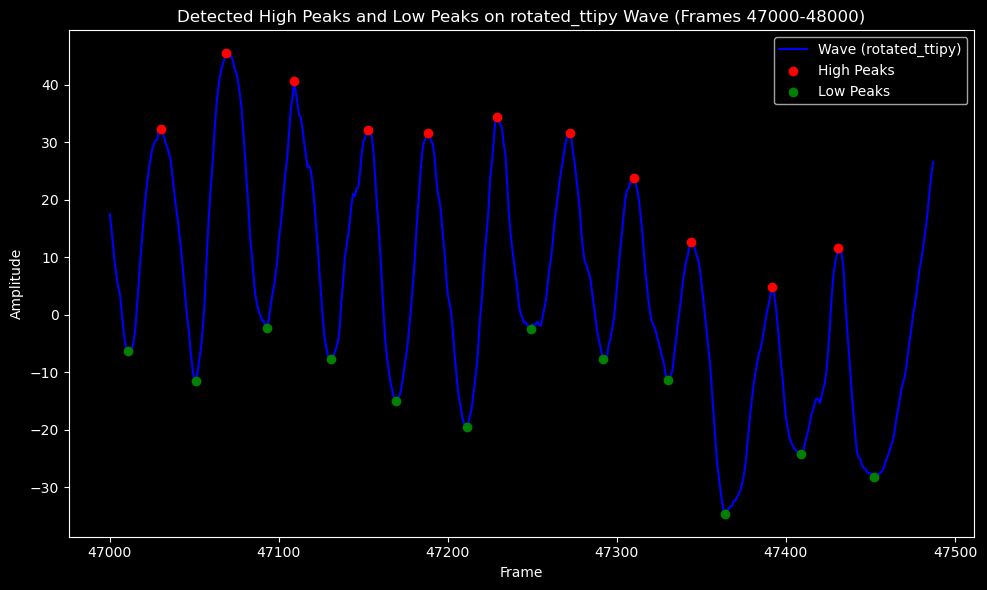

In [19]:
import matplotlib.pyplot as plt
from scipy.signal import find_peaks

# Define frame range
frame_start = 47000
frame_end = 48000

# Filter data to the specified frame range
filtered_data = onefish_in_frames[(onefish_in_frames['frame'] >= frame_start) & (onefish_in_frames['frame'] <= frame_end)]

# Extract filtered tail_y and frame columns
tail_y = filtered_data['rotated_ttipy']
frames = filtered_data['frame']

# Detect high peaks (positive peaks) in the filtered range
high_peaks, _ = find_peaks(tail_y, distance=5, prominence=5)

# Detect low peaks (troughs) in the filtered range by inverting the signal
low_peaks, _ = find_peaks(-tail_y, distance=5, prominence=5)

# Plot the wave with high peaks and low peaks in the filtered range
plt.figure(figsize=(10, 6))  # Set figure size

# Plot the 'rotated_ttipy' wave using frames on the x-axis
plt.plot(frames, tail_y, label='Wave (rotated_ttipy)', color='blue')

# Highlight the high peaks on the wave using frames for x-coordinates
plt.scatter(frames.iloc[high_peaks], tail_y.iloc[high_peaks], color='red', label='High Peaks', zorder=5)

# Highlight the low peaks (troughs) on the wave using frames for x-coordinates
plt.scatter(frames.iloc[low_peaks], tail_y.iloc[low_peaks], color='green', label='Low Peaks', zorder=5)

# Add labels and legend
plt.title(f'Detected High Peaks and Low Peaks on rotated_ttipy Wave (Frames {frame_start}-{frame_end})')
plt.xlabel('Frame')
plt.ylabel('Amplitude')
plt.legend()

# Show the plot
plt.tight_layout()
plt.show()


### Calculate basic kinematics (amplitude,frequncy, strouhal number)

In [20]:
data2 = pd.read_hdf(output_folder + "data2_sharks.h5", key='sharks')

In [21]:
sharks_speed = pd.read_hdf(output_folder + "nn_sharks.h5", key='sharks')
sharks_speed.head()

,index,SPEED#wcentroid,ID,X#pcentroid,Y#pcentroid,ANGLE,frame,time,headx,heady,...,ID_checked,unique_id_count,delta_time,speed,body_length,standardized_speed,nearest_neighbor,nn_distance,mean_body_length,normalized_nnd
0,0,0.000000,0,NaN,NaN,-0.263183,0,0.00,2044.00,685.000000,...,1.0,5.0,NaN,NaN,177.037783,NaN,2.0,127.283149,168.769768,0.754182
1,1,55.754349,0,NaN,NaN,-0.253584,1,0.01,2045.00,685.000000,...,1.0,5.0,NaN,NaN,177.447051,NaN,2.0,126.931576,168.968342,0.751215
2,2,103.976613,0,NaN,NaN,-0.245468,2,0.02,2046.00,684.333333,...,1.0,5.0,NaN,NaN,177.425603,NaN,2.0,126.919156,168.964560,0.751158
3,3,123.176350,0,NaN,NaN,-0.238684,3,0.03,2047.75,684.000000,...,1.0,5.0,NaN,NaN,177.486965,NaN,2.0,126.385571,169.092242,0.747436
4,4,126.865948,0,NaN,NaN,-0.233522,4,0.04,2049.20,683.800000,...,1.0,5.0,NaN,NaN,176.966319,NaN,2.0,125.861908,169.239818,0.743690


In [23]:
data2 = pd.merge(data2, sharks_speed[['Trial', 'ID', 'frame','normalized_nnd', 'mean_body_length','body_length','standardized_speed']], on=['Trial', 'ID', 'frame'], how='left')

In [24]:
data2 = data2[(data2['ID_checked'] == 1) & (data2['drone_movement'] == 0)]

#### Tail beat frequency cauculation

In [25]:
import numpy as np
from scipy.signal import find_peaks
import pandas as pd

# Assume `data2` DataFrame has the necessary columns: 'rotated_ttipy', 'Trial', 'ID', and 'frame'

# Define constants
frame_rate = 50  # Frames per second
window_size = 100  # Number of frames in each window
step_size = 20     # Overlap of 50% between consecutive windows

# Create a new column for tailbeat frequency, initialized with NaN
data2['tailbeat_frequency'] = np.nan

# Loop over each trial and each unique ID in the trial
for trial in data2['Trial'].unique():
    trial_data = data2[data2['Trial'] == trial]
    
    for uid in trial_data['ID'].unique():
        # Filter data for the specific trial and ID
        id_data = trial_data[trial_data['ID'] == uid]
        
        # Extract necessary data
        tail_y = id_data['rotated_ttipy'].values
        frames = id_data['frame'].values
        
        # Detect peaks in the y-coordinate data
        peaks, _ = find_peaks(tail_y, prominence=5, distance=5)
        
        # Detect troughs (negative peaks)
        troughs, _ = find_peaks(-tail_y, prominence=5, distance=5)
        
        # Validate peaks: ensure there is a trough ≤ 0 between each pair of peaks
        valid_peaks = []
        for i in range(len(peaks) - 1):
            peak_start = peaks[i]
            peak_end = peaks[i + 1]
            
            # Find all troughs between the two peaks
            troughs_between = troughs[(troughs > peak_start) & (troughs < peak_end)]
            
            # Check if any trough has a value ≤ 0
            if len(troughs_between):
                valid_peaks.append(peak_start)
        if peaks.size > 0:
            valid_peaks.append(peaks[-1])  # Include the last peak
        
        valid_peaks = np.array(valid_peaks)
        
        # Initialize arrays to store frequency and weights for this ID
        frequencies_per_frame = np.zeros(len(id_data))
        weights = np.zeros(len(id_data))
        
        # Sliding window approach with valid peaks
        for start in range(0, len(tail_y) - window_size, step_size):
            end = start + window_size
            # Find valid peaks within the current window
            window_peaks = valid_peaks[(valid_peaks >= start) & (valid_peaks < end)]
            
            # Get frame intervals in the window
            if len(window_peaks) > 1:
                frame_intervals = np.diff(window_peaks)
                # Calculate mean tail beat frequency for the current window
                mean_frequency = frame_rate / np.mean(frame_intervals)
            else:
                mean_frequency = 0  # If insufficient peaks, frequency is 0
            
            # Assign this mean frequency to the frames in the window
            frequencies_per_frame[start:end] += mean_frequency
            weights[start:end] += 1  # Increment weights for overlapping contributions
        
        # Normalize frequencies by the weights
        frequencies_per_frame = np.divide(
        frequencies_per_frame, weights, where=weights > 0, out=np.zeros_like(frequencies_per_frame)
        )

        
        # Assign the calculated frequencies back to the DataFrame for the current trial and ID
        data2.loc[id_data.index, 'tailbeat_frequency'] = frequencies_per_frame

# Display the updated DataFrame
data2.head()



,index,SPEED#wcentroid,ID,X#pcentroid,Y#pcentroid,ANGLE,frame,time,headx,heady,...,rotated_peduncley,rotated_finx,rotated_finy,rotated_ttipx,rotated_ttipy,normalized_nnd,mean_body_length,body_length,standardized_speed,tailbeat_frequency
0,0,0.000000,0,NaN,NaN,-0.263183,0,0.00,2044.00,685.000000,...,20.282998,-105.970529,29.719473,-123.433430,39.155948,0.754182,168.769768,177.037783,NaN,1.020408
1,1,55.754349,0,NaN,NaN,-0.253584,1,0.01,2045.00,685.000000,...,19.356175,-106.071892,29.301300,-123.143413,39.354319,0.751215,168.968342,177.447051,NaN,1.020408
2,2,103.976613,0,NaN,NaN,-0.245468,2,0.02,2046.00,684.333333,...,18.064002,-105.139993,28.156777,-122.283234,38.973346,0.751158,168.964560,177.425603,NaN,1.020408
3,3,123.176350,0,NaN,NaN,-0.238684,3,0.03,2047.75,684.000000,...,16.094146,-104.763587,26.271066,-121.863412,36.935070,0.747436,169.092242,177.486965,NaN,1.020408
4,4,126.865948,0,NaN,NaN,-0.233522,4,0.04,2049.20,683.800000,...,14.465792,-104.453465,24.299046,-121.485016,34.670463,0.743690,169.239818,176.966319,NaN,1.020408


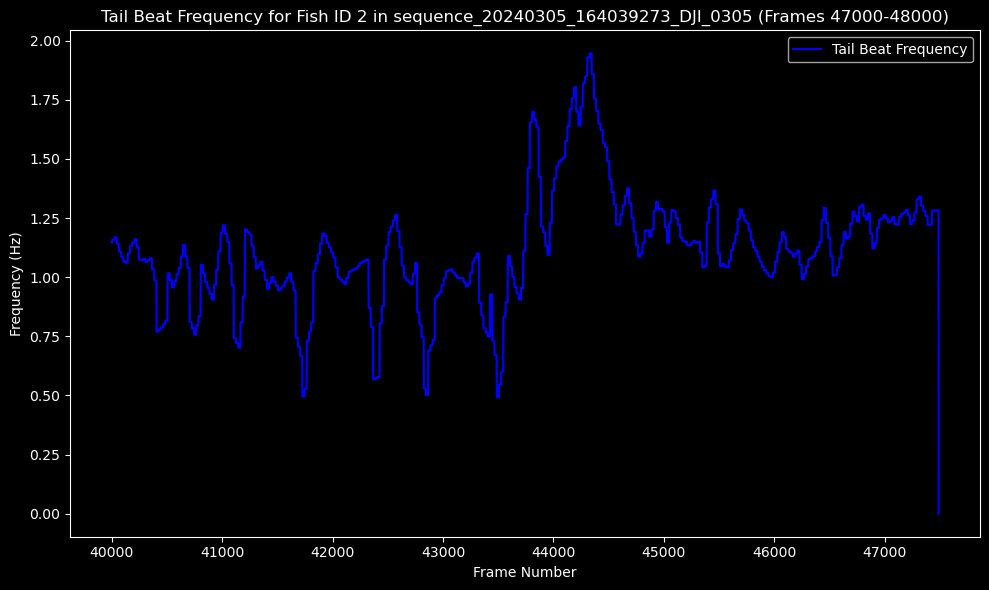

In [26]:
# Define specific trial and fish ID
fish_id = 2  
trial = 'sequence_20240305_164039273_DJI_0305'

# Filter the data for the specified trial and fish ID
filtered_data = data2[(data2['Trial'] == trial) & (data2['ID'] == fish_id)]

# Extract frames and frequencies in the range 47000 to 48000
frame_range = (filtered_data['frame'] >= 40000) & (filtered_data['frame'] <= 47500)
frames = filtered_data['frame'][frame_range]
frequencies = filtered_data['tailbeat_frequency'][frame_range]

# Plot the tailbeat frequency for the filtered data
plt.figure(figsize=(10, 6))
plt.plot(frames, frequencies, label="Tail Beat Frequency", color="b")
plt.xlabel("Frame Number")
plt.ylabel("Frequency (Hz)")
plt.title(f"Tail Beat Frequency for Fish ID {fish_id} in {trial} (Frames 47000-48000)")
plt.legend()
plt.tight_layout()
plt.show()


#### Amplitude

In [62]:
# Add a new column for tailbeat amplitude
data2['tailbeat_amplitude'] = np.nan

# Constants
window_size = 100  # Frames in each window
step_size = 20     # Overlap between consecutive windows

# Loop over each trial and ID
for trial in data2['Trial'].unique():
    trial_data = data2[data2['Trial'] == trial]
    
    for uid in trial_data['ID'].unique():
        # Filter data for the specific trial and ID
        id_data = trial_data[trial_data['ID'] == uid]
        
        # Extract necessary data
        tail_y = id_data['rotated_ttipy'].values
        
        # Detect peaks and troughs
        peaks, _ = find_peaks(tail_y, prominence=5, distance=5)
        troughs, _ = find_peaks(-tail_y, prominence=5, distance=5)
        
        # Validate peaks and calculate amplitudes
        valid_peaks = []
        valid_amplitudes = []
        for peak in peaks:
            # Access the value
            peak_value = tail_y[peak]
            
            # Find the closest preceding or succeeding trough
            preceding_troughs = troughs[troughs < peak]
            succeeding_troughs = troughs[troughs > peak]
            
            closest_trough = None
            if len(preceding_troughs) > 0:
                closest_trough = preceding_troughs[-1]  # Last preceding trough
            if len(succeeding_troughs) > 0:
                if closest_trough is None or abs(succeeding_troughs[0] - peak) < abs(closest_trough - peak):
                    closest_trough = succeeding_troughs[0]  # Closest succeeding trough
            
            # Check if the trough value is below 0
            if closest_trough is not None:
                valid_peaks.append(peak)
                valid_amplitudes.append(peak_value - tail_y[closest_trough])  # Calculate amplitude
        
        valid_peaks = np.array(valid_peaks)
        valid_amplitudes = np.array(valid_amplitudes)
        
        # Initialize arrays for amplitude values and weights
        amplitudes_per_frame = np.zeros(len(id_data))
        weights = np.zeros(len(id_data))
        
        # Sliding window approach with valid peaks
        for start in range(0, len(tail_y) - window_size, step_size):
            end = start + window_size
            # Find valid peaks within the current window
            window_peaks = valid_peaks[(valid_peaks >= start) & (valid_peaks < end)]
            window_amplitudes = valid_amplitudes[(valid_peaks >= start) & (valid_peaks < end)]
            
            # Calculate mean amplitude in the window
            if len(window_peaks) > 0:
                mean_amplitude = np.mean(window_amplitudes)
            else:
                mean_amplitude = 0  # No peaks in the window
            
            # Assign this amplitude to the frames in the window
            amplitudes_per_frame[start:end] += mean_amplitude
            weights[start:end] += 1  # Increment weights for overlapping contributions
        
        # Normalize amplitudes by the weights
        amplitudes_per_frame = np.divide(amplitudes_per_frame, weights, where=weights > 0)
        
        # Assign the calculated amplitudes back to the DataFrame
        data2.loc[id_data.index, 'tailbeat_amplitude'] = amplitudes_per_frame

# Display the updated DataFrame
data2.head()


,index,SPEED#wcentroid,ID,X#pcentroid,Y#pcentroid,ANGLE,frame,time,headx,heady,...,rotated_ttipy,normalized_nnd,mean_body_length,body_length,standardized_speed,tailbeat_frequency,tailbeat_amplitude,standardized_amplitude,strouhal_number,Trial_num
0,0,0.000000,0,NaN,NaN,-0.263183,0,0.00,2044.00,685.000000,...,39.155948,0.754182,168.769768,177.037783,NaN,1.020408,73.417593,0.414700,NaN,0
1,1,55.754349,0,NaN,NaN,-0.253584,1,0.01,2045.00,685.000000,...,39.354319,0.751215,168.968342,177.447051,NaN,1.020408,73.417593,0.413744,NaN,0
2,2,103.976613,0,NaN,NaN,-0.245468,2,0.02,2046.00,684.333333,...,38.973346,0.751158,168.964560,177.425603,NaN,1.020408,73.417593,0.413794,NaN,0
3,3,123.176350,0,NaN,NaN,-0.238684,3,0.03,2047.75,684.000000,...,36.935070,0.747436,169.092242,177.486965,NaN,1.020408,73.417593,0.413651,NaN,0
4,4,126.865948,0,NaN,NaN,-0.233522,4,0.04,2049.20,683.800000,...,34.670463,0.743690,169.239818,176.966319,NaN,1.020408,73.417593,0.414868,NaN,0


In [63]:
# Add a new column for standardized amplitude
data2['standardized_amplitude'] = np.nan

# Loop over each trial and ID
for trial in data2['Trial'].unique():
    trial_data = data2[data2['Trial'] == trial]
    
    for uid in trial_data['ID'].unique():
        # Filter data for the specific trial and ID
        id_data = trial_data[trial_data['ID'] == uid]
        
        # Drop rows where either 'tailbeat_amplitude' or 'body_length' is NaN
        id_data = id_data.dropna(subset=['tailbeat_amplitude', 'body_length'])

        # Calculate standardized amplitude (division by zero is handled naturally since NaNs are dropped)
        standardized_amplitude = id_data['tailbeat_amplitude'] / id_data['body_length']

        # Assign the calculated values back to the original DataFrame
        data2.loc[id_data.index, 'standardized_amplitude'] = standardized_amplitude

# Display the updated DataFrame
data2[['Trial', 'ID', 'tailbeat_amplitude', 'body_length', 'standardized_amplitude']].head()


,Trial,ID,tailbeat_amplitude,body_length,standardized_amplitude
0,sequence_20240303_060726300_DJI_0242,0,73.417593,177.037783,0.414700
1,sequence_20240303_060726300_DJI_0242,0,73.417593,177.447051,0.413744
2,sequence_20240303_060726300_DJI_0242,0,73.417593,177.425603,0.413794
3,sequence_20240303_060726300_DJI_0242,0,73.417593,177.486965,0.413651
4,sequence_20240303_060726300_DJI_0242,0,73.417593,176.966319,0.414868


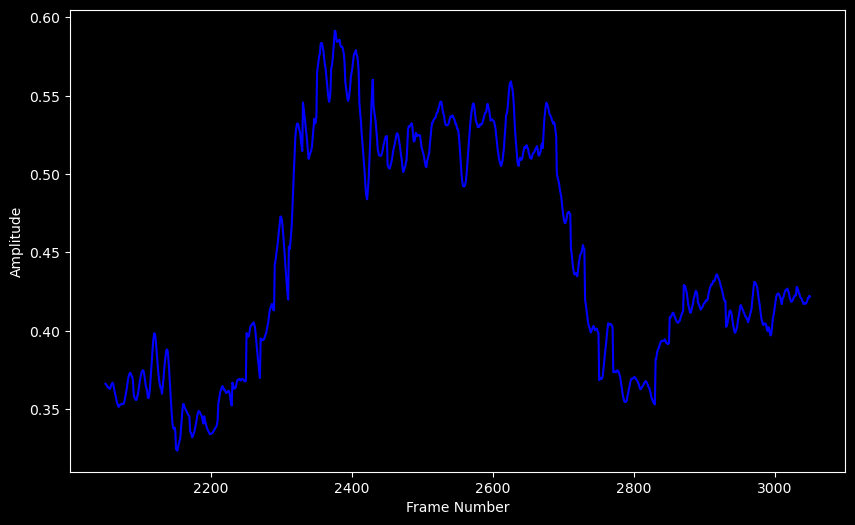

In [64]:
import matplotlib.pyplot as plt
# Define specific trial and fish ID
trial = 'sequence_20240306_161443984_DJI_0139'
fish_id = 1

# Filter the data for the specified trial and fish ID
filtered_data = data2[(data2['Trial'] == trial) & (data2['ID'] == fish_id)]

# Filter the data for the first 100 frames
frames = filtered_data.frame[:1000]
amplitude = filtered_data['standardized_amplitude'][:1000]

# Plot the frequency data
plt.figure(figsize=(10, 6))
plt.plot(frames, amplitude, label="Tail Beat Amplitude", color="b")
plt.xlabel("Frame Number")
plt.ylabel("Amplitude")
plt.show()

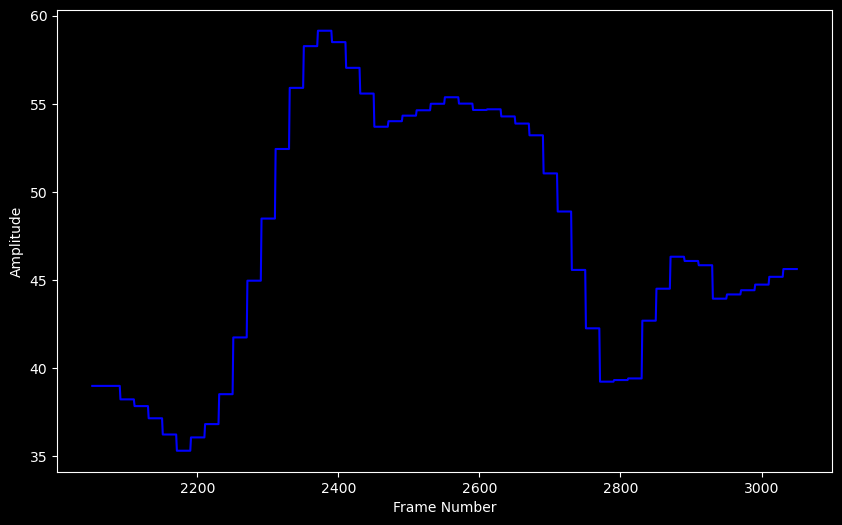

In [65]:
import matplotlib.pyplot as plt
# Define specific trial and fish ID
trial = 'sequence_20240306_161443984_DJI_0139'
fish_id = 1

# Filter the data for the specified trial and fish ID
filtered_data = data2[(data2['Trial'] == trial) & (data2['ID'] == fish_id)]

# Filter the data for the first 100 frames
frames = filtered_data.frame[:1000]
amplitude = filtered_data['tailbeat_amplitude'][:1000]

# Plot the frequency data
plt.figure(figsize=(10, 6))
plt.plot(frames, amplitude, label="Tail Beat Amplitude", color="b")
plt.xlabel("Frame Number")
plt.ylabel("Amplitude")
plt.show()

#### Strouhal number cauculation

In [32]:
import numpy as np

# Add a new column for the Strouhal number
data2['strouhal_number'] = np.nan

# Loop over each trial and ID
for trial in data2['Trial'].unique():
    trial_data = data2[data2['Trial'] == trial]
    
    for uid in trial_data['ID'].unique():
        # Filter data for the specific trial and ID
        id_data = trial_data[trial_data['ID'] == uid]
        
        # Extract the relevant columns
        standardized_speed = id_data['standardized_speed'].replace(0, np.nan)
        tailbeat_frequency = id_data['tailbeat_frequency']
        standardized_amplitude = id_data['standardized_amplitude']
        
        # Calculate Strouhal number (handle NaN values)
        strouhal_number = (tailbeat_frequency * standardized_amplitude) / standardized_speed
        
        # Assign the calculated Strouhal number back to the DataFrame
        data2.loc[id_data.index, 'strouhal_number'] = strouhal_number

# Display the updated DataFrame with Strouhal number
print(data2[['Trial', 'ID', 'tailbeat_frequency', 'standardized_amplitude', 'standardized_speed', 'strouhal_number']].head())


                                  Trial  ID  tailbeat_frequency  \
0  sequence_20240303_060726300_DJI_0242   0            1.020408   
1  sequence_20240303_060726300_DJI_0242   0            1.020408   
2  sequence_20240303_060726300_DJI_0242   0            1.020408   
3  sequence_20240303_060726300_DJI_0242   0            1.020408   
4  sequence_20240303_060726300_DJI_0242   0            1.020408   

   standardized_amplitude  standardized_speed  strouhal_number  
0                0.414700                 NaN              NaN  
1                0.413744                 NaN              NaN  
2                0.413794                 NaN              NaN  
3                0.413651                 NaN              NaN  
4                0.414868                 NaN              NaN  


In [33]:
# Find rows where the value in the column is greater than 1
unusual_points = data2[data2['strouhal_number'] > 1]

# Print the unusual points
print("Unusual Data Points:")
print(unusual_points)

Unusual Data Points:
         index  SPEED#wcentroid  ID  X#pcentroid  Y#pcentroid     ANGLE  \
8479      8479        88.429225   0          NaN          NaN  0.356650   
8480      8480        83.199221   0          NaN          NaN  0.351371   
8481      8481        75.614089   0          NaN          NaN  0.347448   
8482      8482        83.225187   0          NaN          NaN  0.340573   
8483      8483        95.107428   0          NaN          NaN  0.334330   
...        ...              ...  ..          ...          ...       ...   
798950  187670       108.438684   5          NaN          NaN  3.067250   
798951  187671        97.063514   5          NaN          NaN  3.044186   
799370  188191       108.416272   5          NaN          NaN -2.855843   
799371  188192       114.683777   5          NaN          NaN -2.860878   
799372  188193       118.296169   5          NaN          NaN -2.867256   

        frame        time     headx     heady  ...  rotated_ttipx  \
8479     

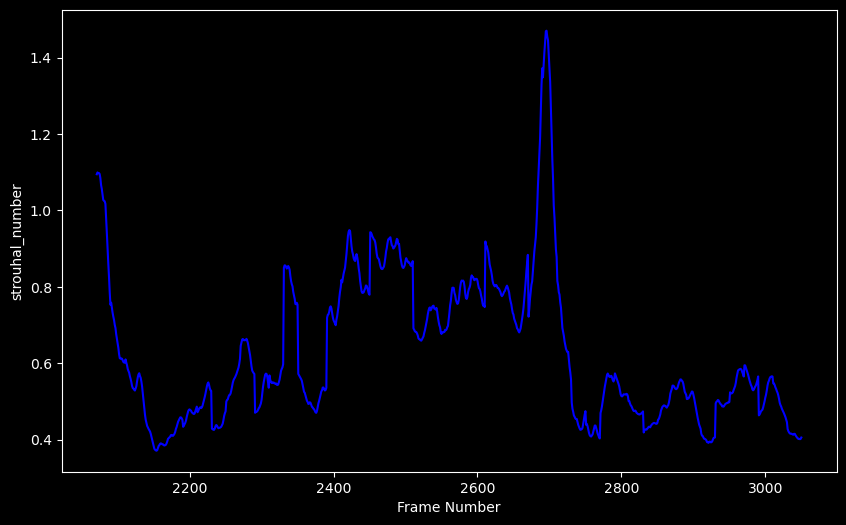

In [34]:
# Define specific trial and fish ID
trial = 'sequence_20240306_161443984_DJI_0139'
fish_id = 1

# Filter the data for the specified trial and fish ID
filtered_data = data2[(data2['Trial'] == trial) & (data2['ID'] == fish_id)]

# Filter the data for the first 100 frames
frames = filtered_data.frame[:1000]
amplitude = filtered_data['strouhal_number'][:1000]

# Plot the frequency data
plt.figure(figsize=(10, 6))
plt.plot(frames, amplitude, label="strouhal_number", color="b")
plt.xlabel("Frame Number")
plt.ylabel("strouhal_number")
plt.show()

In [35]:
# Define variables for fish ID and frame range
fish_id = 1  
trial = 'sequence_20240305_164039273_DJI_0305'  

# Filter data for the specific fish ID
onefish = data2[(data2['ID'] == fish_id) & (data2['Trial'] == trial)]

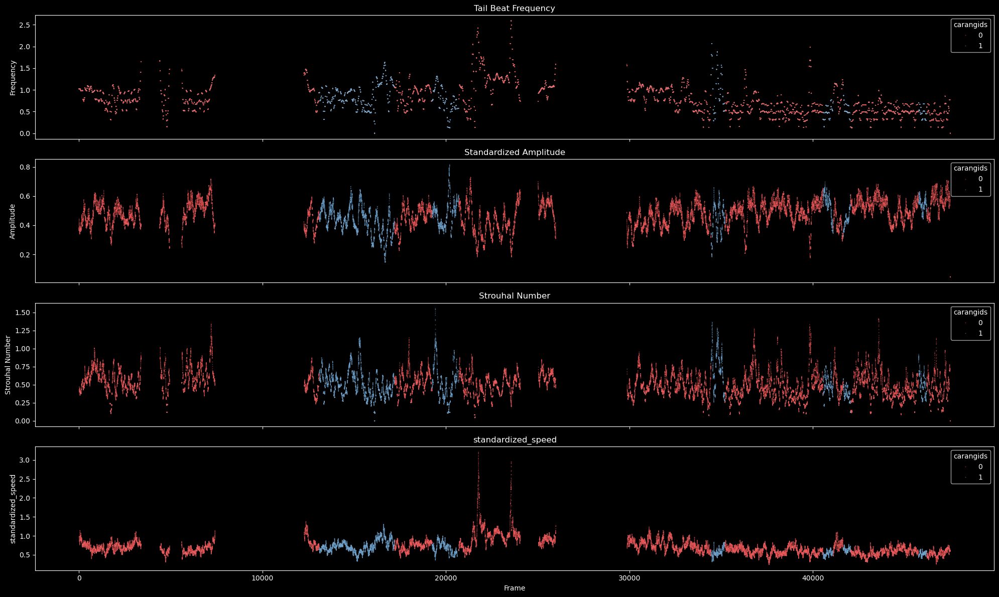

In [36]:
import matplotlib.pyplot as plt
import seaborn as sns

# Create subplots for frequency, amplitude, and Strouhal number
fig, axes = plt.subplots(4, 1, figsize=(20, 12), sharex=True)

# Plot for tailbeat frequency
sns.scatterplot(
    x='frame', y='tailbeat_frequency', data=onefish, 
    hue='carangids', palette="Set1", s=1, alpha=0.7, ax=axes[0]
)
axes[0].set_xlabel('Frame')
axes[0].set_ylabel('Frequency')
axes[0].set_title('Tail Beat Frequency')

# Plot for standardized amplitude
sns.scatterplot(
    x='frame', y='standardized_amplitude', data=onefish, 
    hue='carangids', palette="Set1", s=1, alpha=0.7, ax=axes[1]
)
axes[1].set_xlabel('Frame')
axes[1].set_ylabel('Amplitude')
axes[1].set_title('Standardized Amplitude')

# Plot for Strouhal number
sns.scatterplot(
    x='frame', y='strouhal_number', data=onefish, 
    hue='carangids', palette="Set1", s=1, alpha=0.7, ax=axes[2]
)
axes[2].set_xlabel('Frame')
axes[2].set_ylabel('Strouhal Number')
axes[2].set_title('Strouhal Number')

# Plot for Strouhal number
sns.scatterplot(
    x='frame', y='standardized_speed', data=onefish, 
    hue='carangids', palette="Set1", s=1, alpha=0.7, ax=axes[3]
)
axes[3].set_xlabel('Frame')
axes[3].set_ylabel('standardized_speed')
axes[3].set_title('standardized_speed')

# Limit the y-axis to 2
#axes[2].set_ylim(0, 1.2)

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plot
plt.show()



In [70]:
# Save sharks_df to HDF5
sharks_output_file = os.path.join(output_folder, "kinematics_sharks.h5")
data2.to_hdf(sharks_output_file, key='sharks', mode='w')
print(f"Shark data saved to {sharks_output_file}")

Shark data saved to C:/Seafile//BSc_data//processed_data/kinematics_sharks.h5


#### Graphs

In [48]:
data2 = pd.read_hdf(output_folder + "kinematics_sharks.h5", key='sharks')
data2.head()

,index,SPEED#wcentroid,ID,X#pcentroid,Y#pcentroid,ANGLE,frame,time,headx,heady,...,rotated_ttipx,rotated_ttipy,normalized_nnd,mean_body_length,body_length,standardized_speed,tailbeat_frequency,tailbeat_amplitude,standardized_amplitude,strouhal_number
0,0,0.000000,0,NaN,NaN,-0.263183,0,0.00,2044.00,685.000000,...,-123.433430,39.155948,0.754182,168.769768,177.037783,NaN,1.020408,73.417593,0.414700,NaN
1,1,55.754349,0,NaN,NaN,-0.253584,1,0.01,2045.00,685.000000,...,-123.143413,39.354319,0.751215,168.968342,177.447051,NaN,1.020408,73.417593,0.413744,NaN
2,2,103.976613,0,NaN,NaN,-0.245468,2,0.02,2046.00,684.333333,...,-122.283234,38.973346,0.751158,168.964560,177.425603,NaN,1.020408,73.417593,0.413794,NaN
3,3,123.176350,0,NaN,NaN,-0.238684,3,0.03,2047.75,684.000000,...,-121.863412,36.935070,0.747436,169.092242,177.486965,NaN,1.020408,73.417593,0.413651,NaN
4,4,126.865948,0,NaN,NaN,-0.233522,4,0.04,2049.20,683.800000,...,-121.485016,34.670463,0.743690,169.239818,176.966319,NaN,1.020408,73.417593,0.414868,NaN


In [49]:
data2['Trial_num']= data2['Trial'].astype('category').cat.codes

In [50]:
example_avg_ID = data2[['ID','carangids','tailbeat_frequency','Trial_num']].groupby(['carangids','Trial_num','ID']).mean().reset_index()
example_avg = data2[['carangids','tailbeat_frequency','Trial_num']].groupby(['carangids','Trial_num']).mean().reset_index()


In [51]:
exampleavg = data2[['carangids','standardized_amplitude','Trial_num']].groupby(['carangids','Trial_num']).mean().reset_index()
exampleavgID = data2[['ID','carangids','standardized_amplitude','Trial_num']].groupby(['carangids','Trial_num','ID']).mean().reset_index()


In [52]:
example = data2[['carangids','strouhal_number','Trial_num']].groupby(['carangids','Trial_num']).mean().reset_index()
exampleaID = data2[['ID','carangids','strouhal_number','Trial_num']].groupby(['carangids','Trial_num','ID']).mean().reset_index()


In [53]:
# Find rows where the value in the column is greater than 1
unusual_points = example[example['strouhal_number'] > 1]

# Print the unusual points
print("Unusual Data Points:")
print(unusual_points)

Unusual Data Points:
Empty DataFrame
Columns: [carangids, Trial_num, strouhal_number]
Index: []


C:\Users\sophi\AppData\Local\Temp\ipykernel_14220\11404183.py:1: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='carangids',y='tailbeat_frequency',data = example_avg_ID, palette="Set1")


<Axes: xlabel='carangids', ylabel='tailbeat_frequency'>

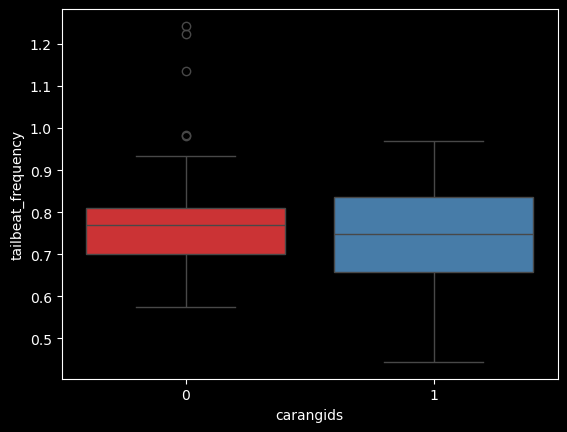

In [66]:
sns.boxplot(x='carangids',y='tailbeat_frequency',data = example_avg_ID, palette="Set1")

C:\Users\sophi\AppData\Local\Temp\ipykernel_14220\841823795.py:1: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='carangids',y='standardized_amplitude',data = exampleavg, palette="Set1")


<Axes: xlabel='carangids', ylabel='standardized_amplitude'>

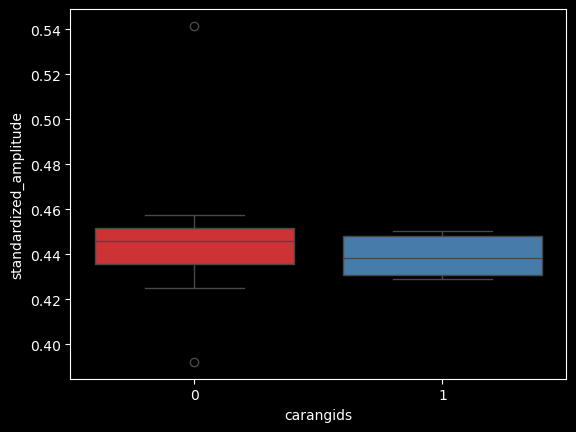

In [67]:
sns.boxplot(x='carangids',y='standardized_amplitude',data = exampleavg, palette="Set1")

C:\Users\sophi\AppData\Local\Temp\ipykernel_14220\940820311.py:1: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='carangids',y='strouhal_number',data = exampleaID, palette="Set1")


<Axes: xlabel='carangids', ylabel='strouhal_number'>

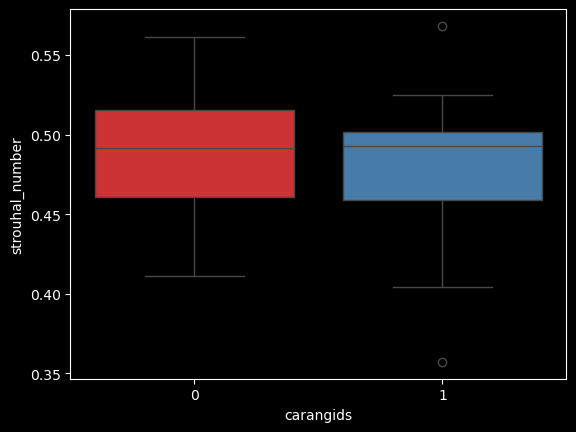

In [68]:
sns.boxplot(x='carangids',y='strouhal_number',data = exampleaID, palette="Set1")

In [59]:
tailbeatID = subset[['unique_id_count','tailbeat_frequency','Trial_num','ID','segment']].groupby(['unique_id_count','Trial_num','ID', 'segment']).mean().reset_index()
amplitudeID = subset[['unique_id_count','standardized_amplitude','Trial_num','ID','segment']].groupby(['unique_id_count','Trial_num','ID', 'segment']).mean().reset_index()
strouhalID = subset[['unique_id_count','strouhal_number','Trial_num','ID','segment']].groupby(['unique_id_count','Trial_num','ID', 'segment']).mean().reset_index()

KeyError: "['unique_id_count'] not in index"

C:\Users\sophi\AppData\Local\Temp\ipykernel_26588\2599416204.py:1: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='unique_id_count',y='tailbeat_frequency',data = tailbeatID, palette="Set1")


<Axes: xlabel='unique_id_count', ylabel='tailbeat_frequency'>

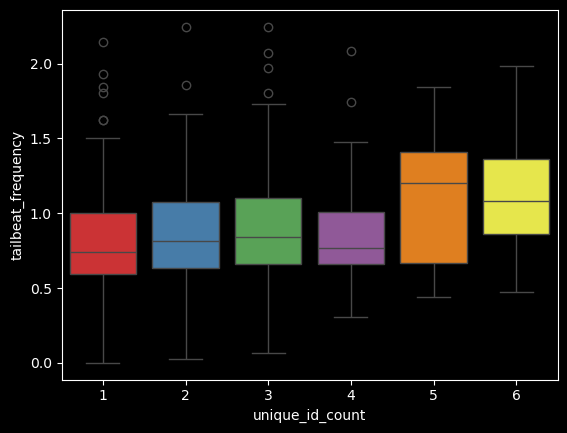

In [29]:
sns.boxplot(x='unique_id_count',y='tailbeat_frequency',data = tailbeatID, palette="Set1")

C:\Users\sophi\AppData\Local\Temp\ipykernel_26588\2242011334.py:1: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='unique_id_count',y='standardized_amplitude',data = amplitudeID, palette="Set1")


<Axes: xlabel='unique_id_count', ylabel='standardized_amplitude'>

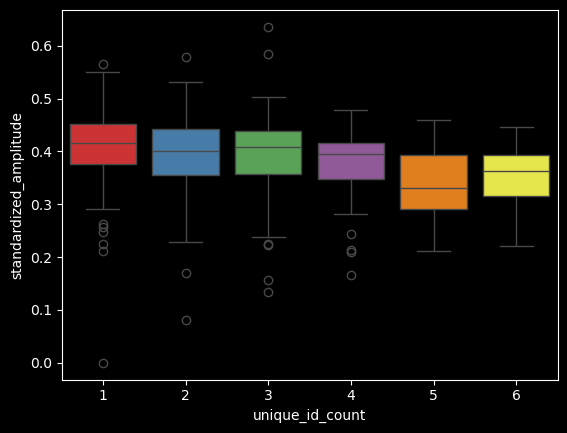

In [30]:
sns.boxplot(x='unique_id_count',y='standardized_amplitude',data = amplitudeID, palette="Set1")

C:\Users\sophi\AppData\Local\Temp\ipykernel_26588\4184661524.py:1: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='unique_id_count',y='strouhal_number',data = strouhalID, palette="Set1")


<Axes: xlabel='unique_id_count', ylabel='strouhal_number'>

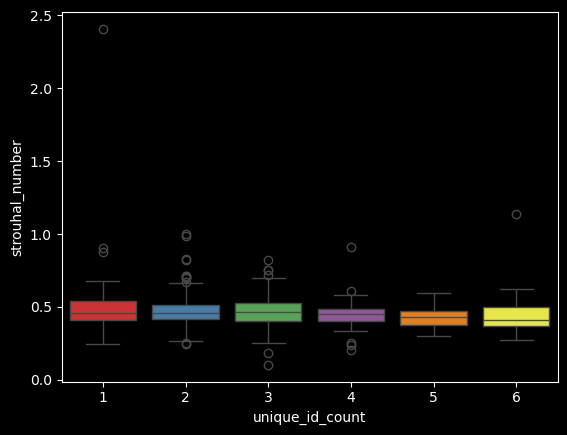

In [31]:
sns.boxplot(x='unique_id_count',y='strouhal_number',data = strouhalID, palette="Set1")

C:\Users\sophi\AppData\Local\Temp\ipykernel_14220\3197112316.py:35: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Carangid", y=metric, data=avg_df, palette=palette)
C:\Users\sophi\AppData\Local\Temp\ipykernel_14220\3197112316.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.stripplot(


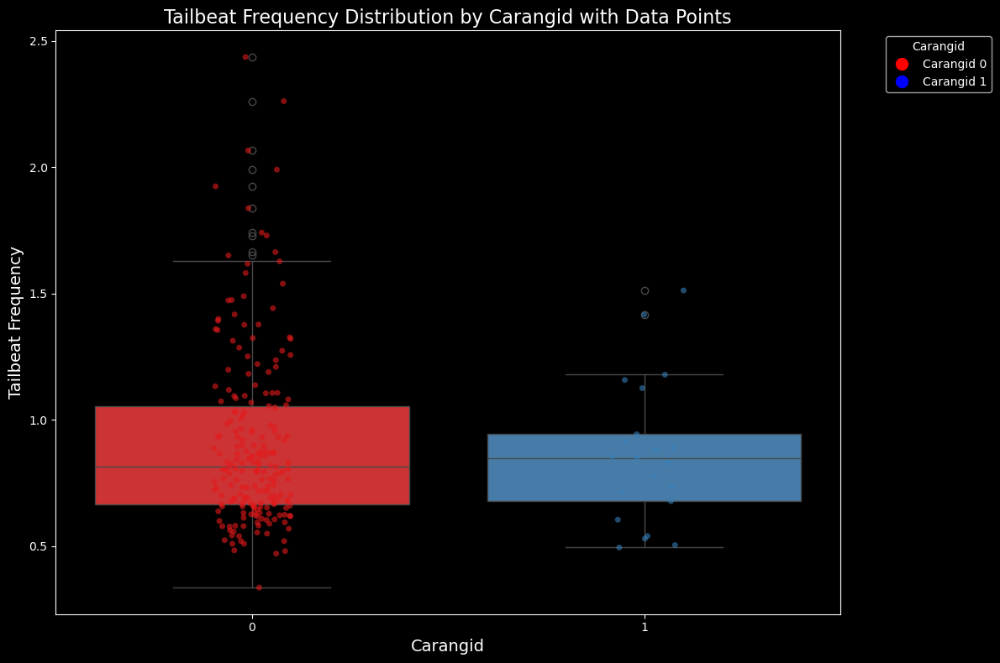

C:\Users\sophi\AppData\Local\Temp\ipykernel_14220\3197112316.py:35: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Carangid", y=metric, data=avg_df, palette=palette)
C:\Users\sophi\AppData\Local\Temp\ipykernel_14220\3197112316.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.stripplot(


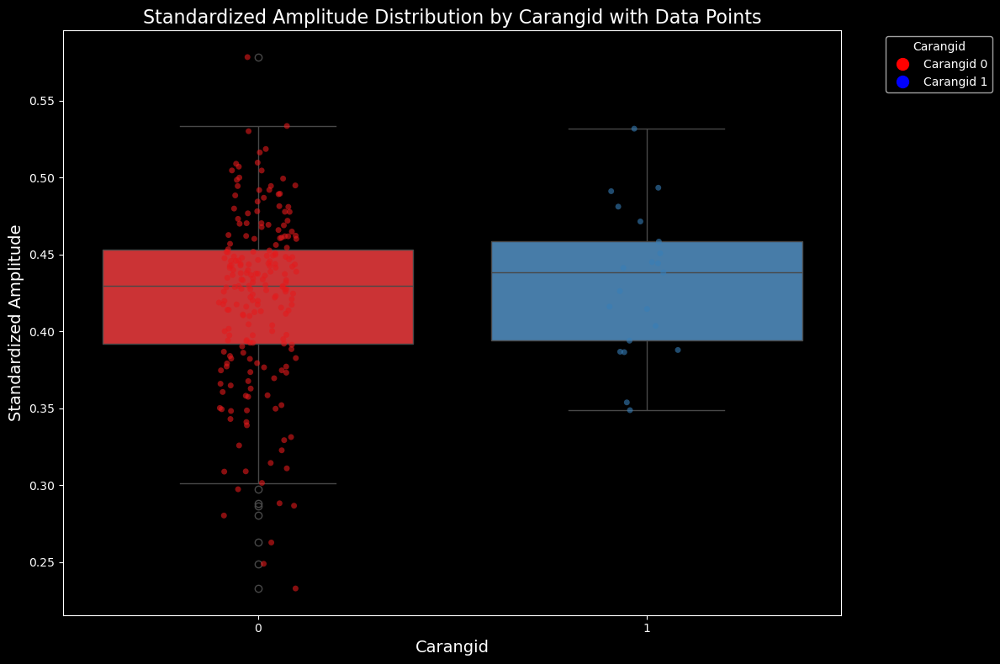

C:\Users\sophi\AppData\Local\Temp\ipykernel_14220\3197112316.py:35: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Carangid", y=metric, data=avg_df, palette=palette)
C:\Users\sophi\AppData\Local\Temp\ipykernel_14220\3197112316.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.stripplot(


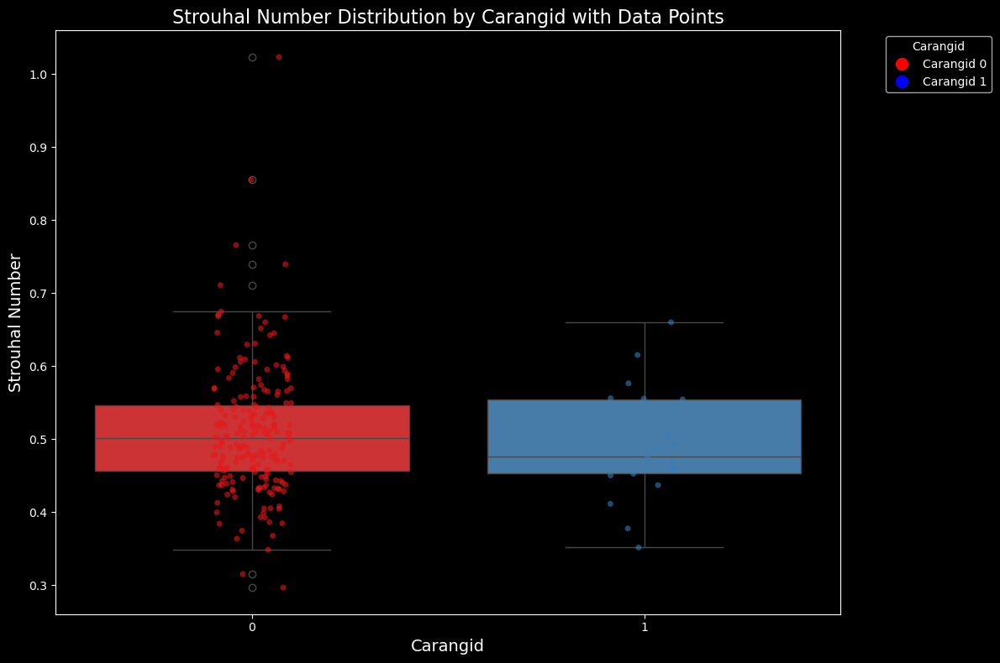

In [69]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Function to calculate averages for multiple metrics with filtering
def calculate_segment_averages(data, metrics, min_count=100):
    averages = []
    for trial, trial_data in data.groupby('Trial'):
        for id_, id_data in trial_data.groupby('ID'):
            for segment, segment_data in id_data.groupby('segment'):  # Group by 'segment'
                if len(segment_data) >= min_count:  # Filter by minimum count
                    avg_values = {metric: segment_data[metric].mean() for metric in metrics}
                    avg_values['Trial'] = trial  # Add Trial information
                    avg_values['Carangid'] = segment_data['carangids'].iloc[0]  # Add carangid info
                    averages.append(avg_values)  # Append average values for all metrics
    return pd.DataFrame(averages)

# Metrics to plot
metrics = ['tailbeat_frequency', 'standardized_amplitude', 'strouhal_number']

# Calculate the averages for the metrics
avg_df = calculate_segment_averages(data2, metrics)

# Ensure 'Carangid' is treated as a categorical variable
avg_df['Carangid'] = avg_df['Carangid'].astype('category')

# Define color palette for carangid (0: red, 1: blue) with string keys to match the data
palette="Set1"

# Create plots for each metric
for metric in metrics:
    plt.figure(figsize=(12, 8))

    # Box plot for the current metric, with x as 'Carangid' and the specified color palette
    sns.boxplot(x="Carangid", y=metric, data=avg_df, palette=palette)

    # Overlay strip plot for data points with the same color palette
    sns.stripplot(
        x="Carangid", y=metric, data=avg_df, palette=palette, marker="o", alpha=0.6, jitter=True
    )

    # Add legend using Carangid values (0: red, 1: blue)
    handles = [
        plt.Line2D([0], [0], marker='o', color='red', linestyle='', markersize=10, label='Carangid 0'),
        plt.Line2D([0], [0], marker='o', color='blue', linestyle='', markersize=10, label='Carangid 1')
    ]
    plt.legend(handles=handles, title='Carangid', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Title and labels
    plt.title(f'{metric.replace("_", " ").title()} Distribution by Carangid with Data Points', fontsize=16)
    plt.xlabel("Carangid", fontsize=14)
    plt.ylabel(metric.replace("_", " ").title(), fontsize=14)

    # Adjust layout for better readability
    plt.tight_layout()
    plt.show()


C:\Users\sophi\AppData\Local\Temp\ipykernel_26588\1213682015.py:31: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Trial", y=metric, data=avg_df, palette=palette)
C:\Users\sophi\AppData\Local\Temp\ipykernel_26588\1213682015.py:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.stripplot(


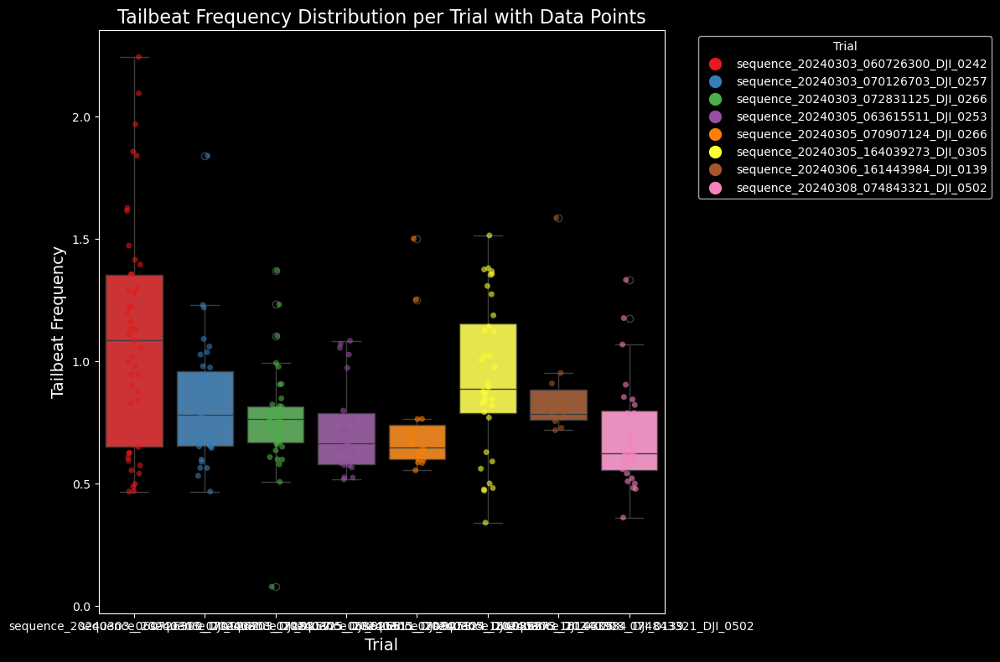

C:\Users\sophi\AppData\Local\Temp\ipykernel_26588\1213682015.py:31: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Trial", y=metric, data=avg_df, palette=palette)
C:\Users\sophi\AppData\Local\Temp\ipykernel_26588\1213682015.py:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.stripplot(


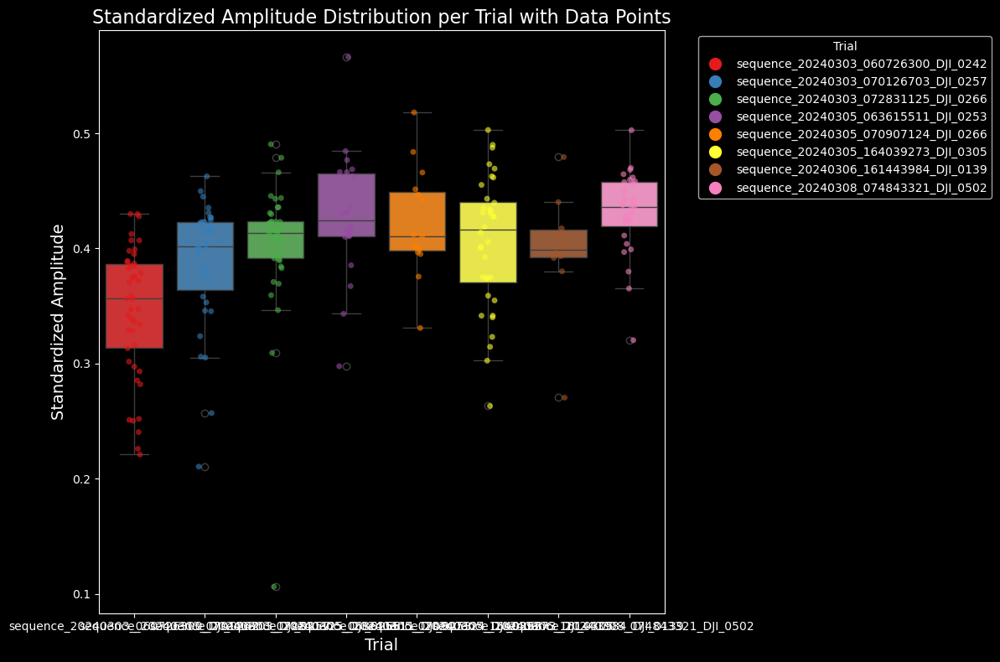

C:\Users\sophi\AppData\Local\Temp\ipykernel_26588\1213682015.py:31: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Trial", y=metric, data=avg_df, palette=palette)
C:\Users\sophi\AppData\Local\Temp\ipykernel_26588\1213682015.py:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.stripplot(


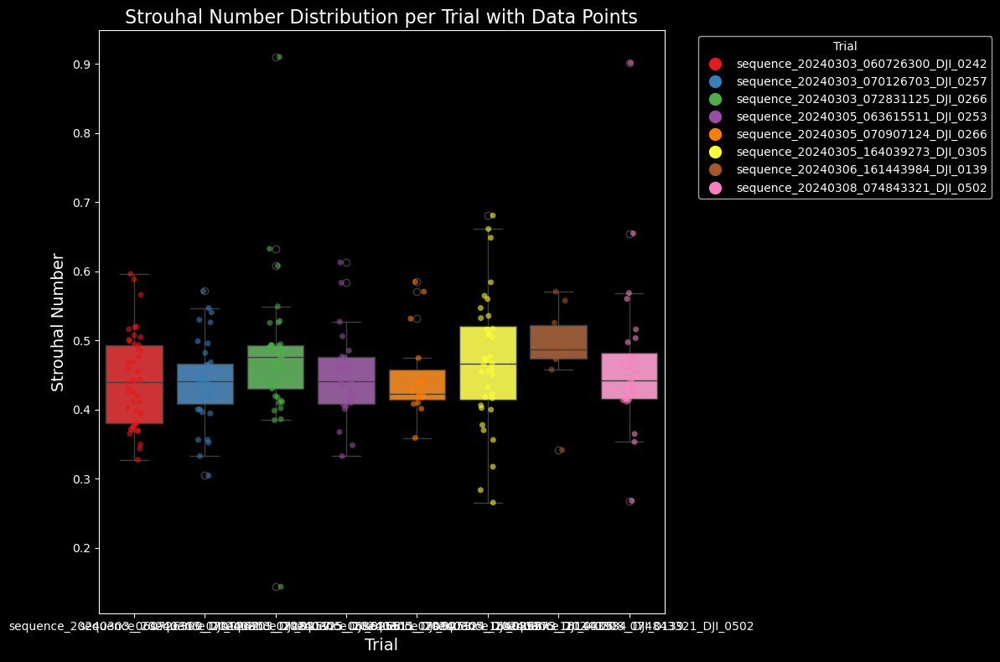

In [33]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Function to calculate averages for multiple metrics with filtering
def calculate_segment_averages(data, metrics, min_count=100):
    averages = []
    for trial, trial_data in data.groupby('Trial'):
        for id_, id_data in trial_data.groupby('ID'):
            for segment, segment_data in id_data.groupby('segment'):  # Group by 'segment'
                if len(segment_data) >= min_count:  # Filter by minimum count
                    avg_values = {metric: segment_data[metric].mean() for metric in metrics}
                    avg_values['Trial'] = trial  # Add Trial information
                    averages.append(avg_values)  # Append average values for all metrics
    return pd.DataFrame(averages)

# Metrics to plot
metrics = ['tailbeat_frequency', 'standardized_amplitude', 'strouhal_number']

# Calculate the averages for the metrics
avg_df = calculate_segment_averages(data2, metrics)

# Create plots for each metric
for metric in metrics:
    plt.figure(figsize=(12, 8))

    # Generate unique colors for each Trial
    palette = sns.color_palette("Set1", n_colors=avg_df['Trial'].nunique())

    # Box plot for the current metric
    sns.boxplot(x="Trial", y=metric, data=avg_df, palette=palette)

    # Overlay strip plot for data points with the same palette
    sns.stripplot(
        x="Trial", y=metric, data=avg_df, palette=palette, marker="o", alpha=0.6, jitter=True
    )

    # Add legend using unique Trial names
    handles = [
        plt.Line2D([0], [0], marker='o', color=palette[i], linestyle='', markersize=10, label=trial)
        for i, trial in enumerate(avg_df['Trial'].unique())
    ]
    plt.legend(handles=handles, title='Trial', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Title and labels
    plt.title(f'{metric.replace("_", " ").title()} Distribution per Trial with Data Points', fontsize=16)
    plt.xlabel("Trial", fontsize=14)
    plt.ylabel(metric.replace("_", " ").title(), fontsize=14)

    # Adjust layout for better readability
    plt.tight_layout()
    plt.show()


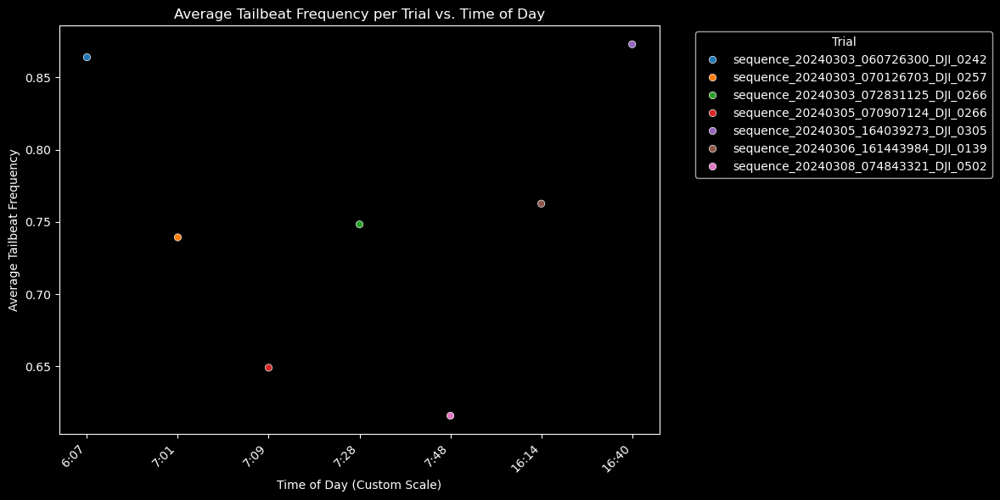

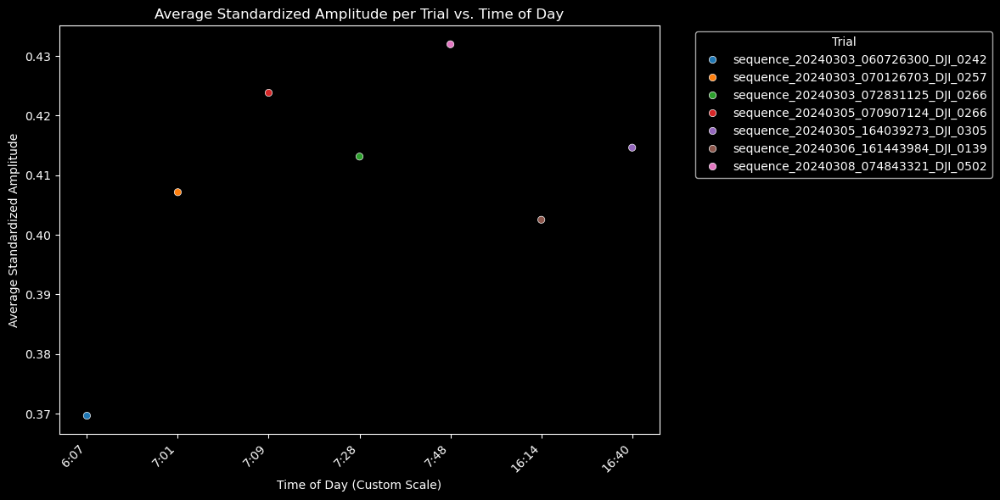

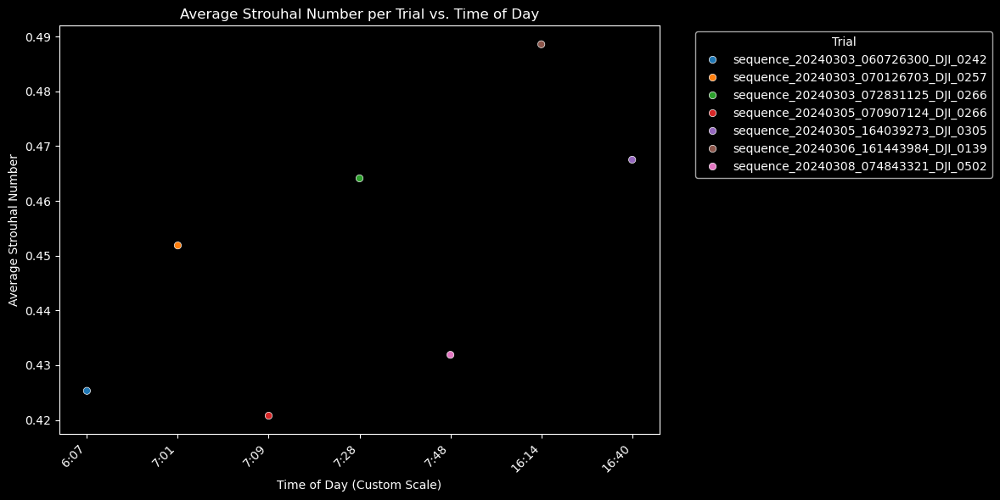

In [63]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
from datetime import datetime, timedelta

# Function to parse the time of day from the trial name
def parse_start_time(trial_name):
    time_part = trial_name.split('_')[2]  # Extract the time from the trial name (HHMMSSsss)
    time_str = f"{time_part[:2]}:{time_part[2:4]}:{time_part[4:6]}.{time_part[6:]}"  # Format time
    return datetime.strptime(time_str, '%H:%M:%S.%f').time()  # Convert to time object

# Convert time to seconds since midnight
def time_to_seconds(time_obj):
    return time_obj.hour * 3600 + time_obj.minute * 60 + time_obj.second + time_obj.microsecond / 1e6

# Metrics to process
metrics = ['tailbeat_frequency', 'standardized_amplitude', 'strouhal_number']

# Loop through metrics to calculate averages and plot
for metric in metrics:
    # Calculate average metric values for each trial
    average_values = []
    trial_start_times = []
    
    for trial, trial_data in data2.groupby('Trial'):
        avg_value = trial_data[metric].mean()  # Compute the average value for the metric
        start_time = parse_start_time(trial)  # Get the start time of the trial
        average_values.append(avg_value)
        trial_start_times.append(start_time)
    
    # Create a DataFrame for the average values and start times
    avg_df = pd.DataFrame({
        'Trial': list(data2['Trial'].unique()),  # Ensure consistent Trial ordering
        metric: average_values,
        'start_time': trial_start_times
    })

    # Convert start time to seconds for plotting
    avg_df['start_time_seconds'] = avg_df['start_time'].apply(time_to_seconds)

    # Custom mapping: Re-scale time to remove gaps
    valid_seconds = avg_df['start_time_seconds'].sort_values().unique()
    custom_x_mapping = {v: i for i, v in enumerate(valid_seconds)}
    avg_df['custom_x'] = avg_df['start_time_seconds'].map(custom_x_mapping)

    # Plot the data using seaborn
    plt.figure(figsize=(12, 6))

    # Scatter plot with the custom x-axis
    sns.scatterplot(
        data=avg_df, 
        x='custom_x', 
        y=metric, 
        hue='Trial', 
        palette='tab10'
    )

    # Add labels and title
    plt.xlabel('Time of Day (Custom Scale)')
    plt.ylabel(f'Average {metric.replace("_", " ").title()}')
    plt.title(f'Average {metric.replace("_", " ").title()} per Trial vs. Time of Day')
    plt.legend(title='Trial', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Format the x-axis labels with original time
    plt.xticks(
        ticks=range(len(valid_seconds)), 
        labels=[str(timedelta(seconds=int(t)))[:-3] for t in valid_seconds], 
        rotation=45, ha='right'
    )

    plt.tight_layout()
    plt.show()


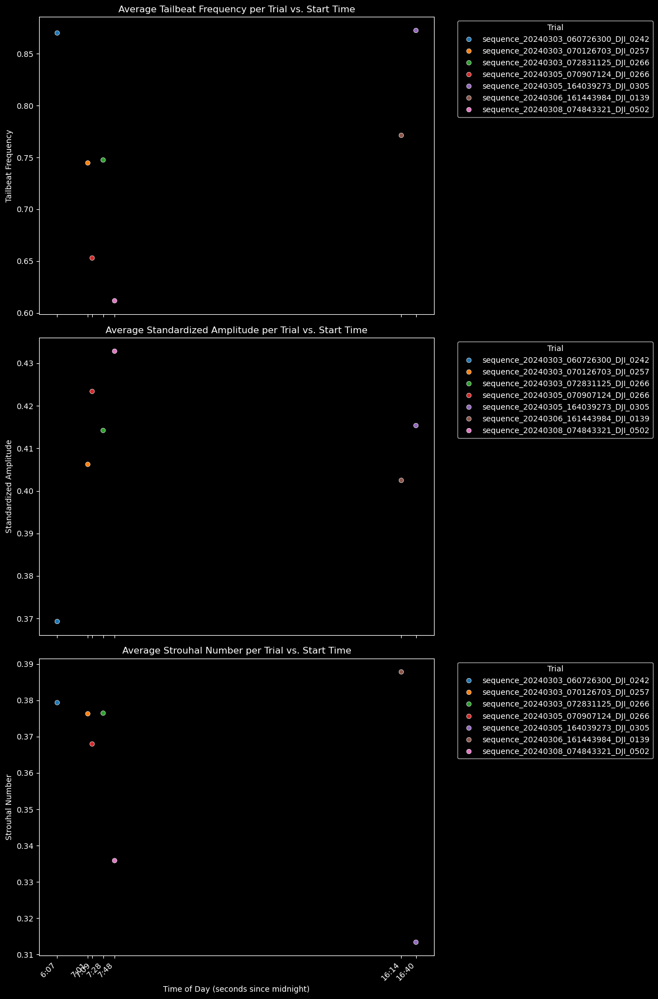

In [36]:

# Function to parse time from the trial name
def parse_start_time(trial_name):
    time_part = trial_name.split('_')[2]  # Extract the time part
    time_str = f"{time_part[:2]}:{time_part[2:4]}:{time_part[4:6]}.{time_part[6:]}"  # HH:MM:SS.mmm
    return datetime.strptime(time_str, '%H:%M:%S.%f').time()

# Convert time object to seconds since midnight
def time_to_seconds(time_obj):
    return time_obj.hour * 3600 + time_obj.minute * 60 + time_obj.second + time_obj.microsecond / 1e6

# Function to calculate averages for a metric
def calculate_averages(data, metric):
    average_values = []
    trial_start_times = []
    trials = []

    for trial, trial_data in data.groupby('Trial'):
        avg_value = trial_data[metric].mean()
        start_time = parse_start_time(trial)
        average_values.append(avg_value)
        trial_start_times.append(time_to_seconds(start_time))
        trials.append(trial)

    return pd.DataFrame({
        'Trial': trials,
        metric: average_values,
        'start_time_seconds': trial_start_times
    })

# Metrics to plot
metrics = ['tailbeat_frequency', 'standardized_amplitude', 'strouhal_number']

# Create subplots
fig, axes = plt.subplots(3, 1, figsize=(12, 18), sharex=True)

for ax, metric in zip(axes, metrics):
    avg_df = calculate_averages(data2, metric)
    sns.scatterplot(
        data=avg_df,
        x='start_time_seconds',
        y=metric,
        hue='Trial',
        palette='tab10',
        ax=ax
    )
    ax.set_title(f'Average {metric.replace("_", " ").title()} per Trial vs. Start Time')
    ax.set_ylabel(metric.replace("_", " ").title())
    ax.legend(title='Trial', bbox_to_anchor=(1.05, 1), loc='upper left')

# Add common x-label
axes[-1].set_xlabel('Time of Day (seconds since midnight)')

# Format x-axis ticks to show HH:MM:SS
for ax in axes:
    ax.set_xticks(avg_df['start_time_seconds'])
    ax.set_xticklabels(
        [str(timedelta(seconds=int(t)))[:-3] for t in avg_df['start_time_seconds']],
        rotation=45,
        ha='right'
    )

plt.tight_layout()
plt.show()

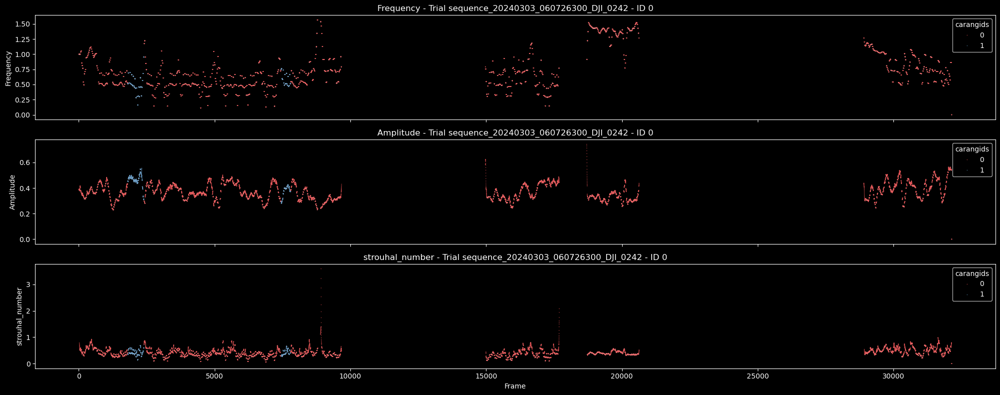

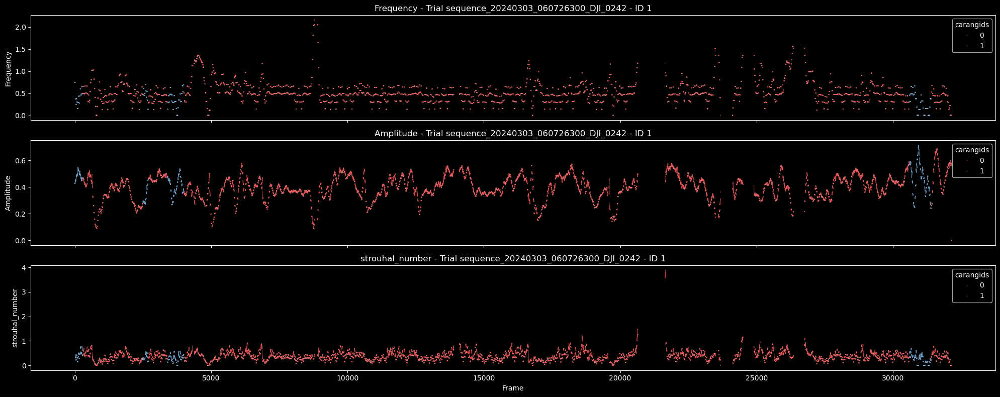

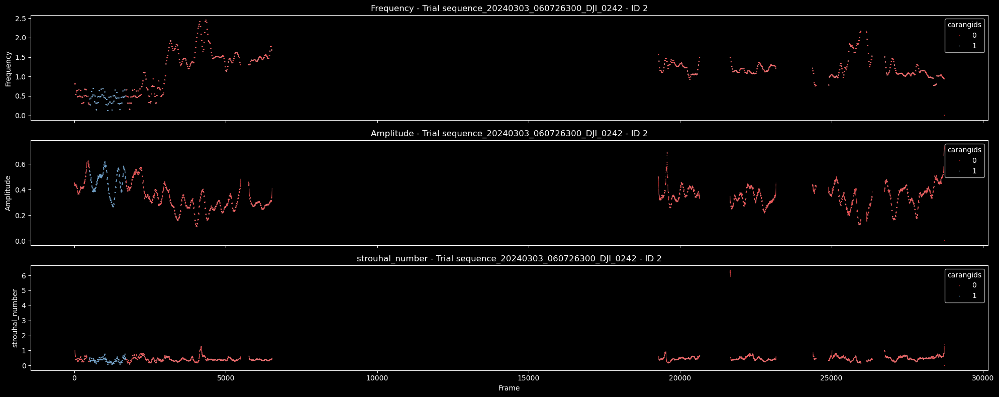

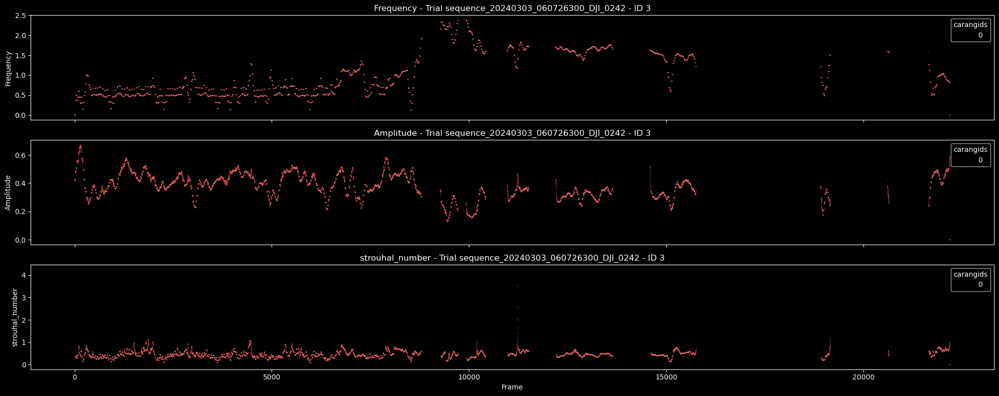

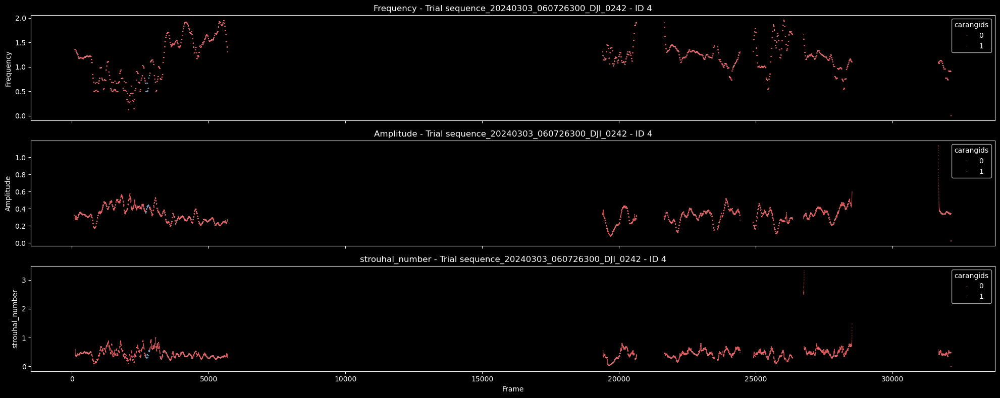

...

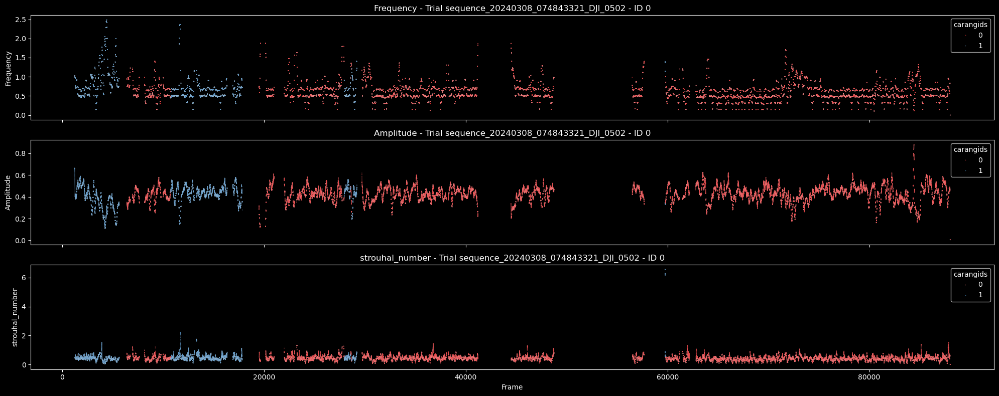

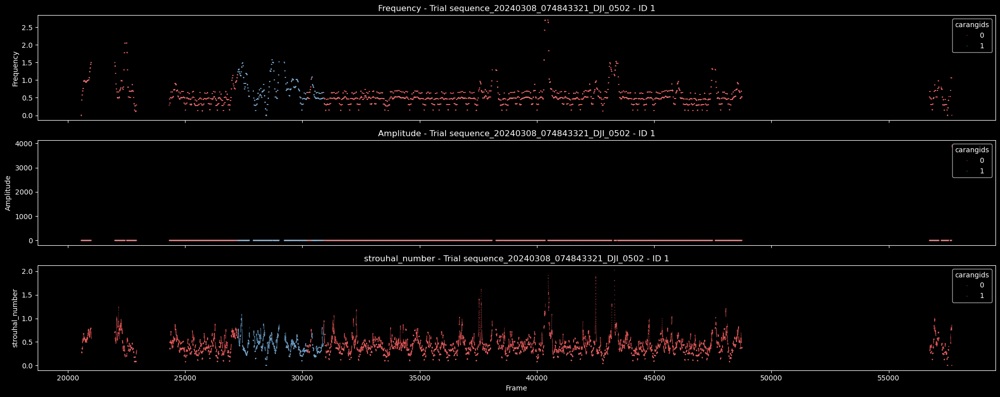

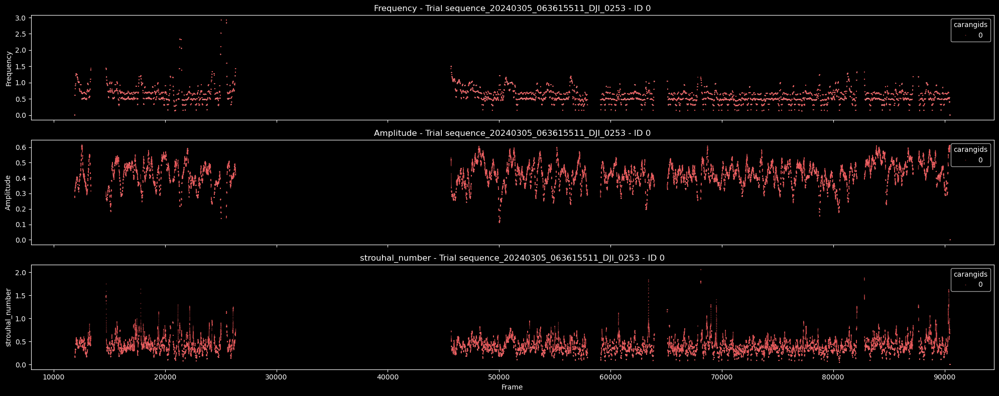

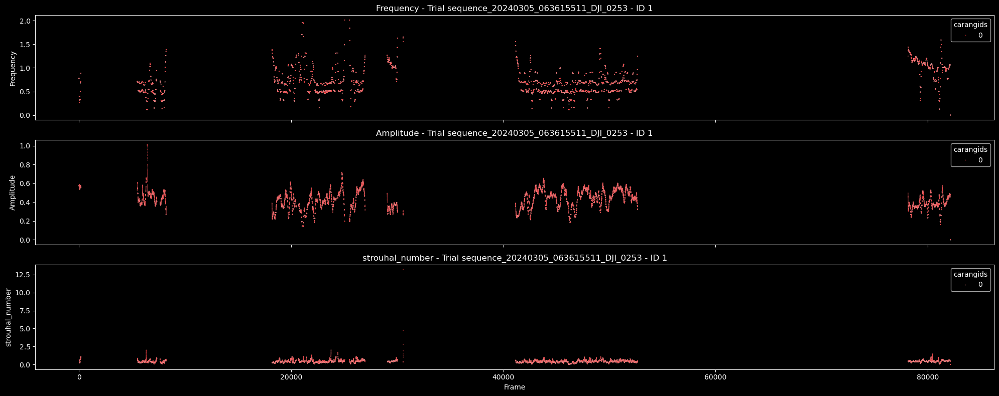

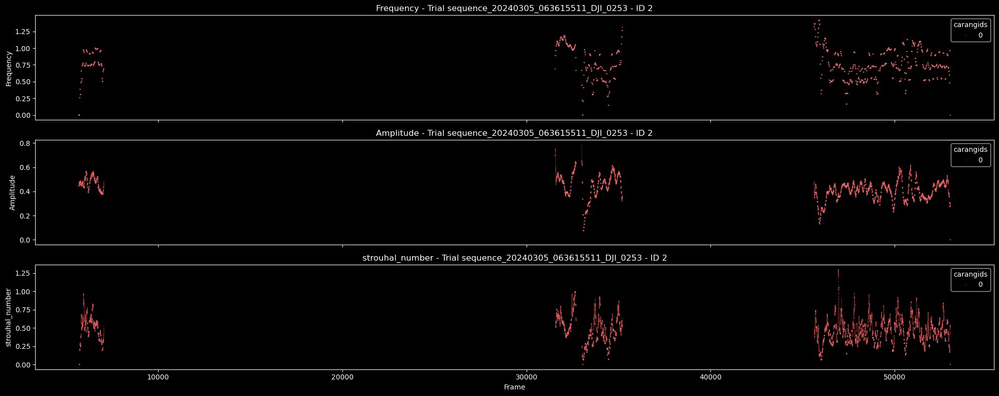

In [57]:
# Loop through each unique Trial
for trial in data2['Trial'].unique():
    trial_data = data2[data2['Trial'] == trial]  # Filter data for the current trial
    
    # Loop through each unique ID in the current trial
    for i in trial_data['ID'].unique():
        # Create subplots for frequency and amplitude
        fig, axes = plt.subplots(3, 1, figsize=(20, 8), sharex=True)
        
        # Filter the data for the current ID and Trial
        fish_data = trial_data[trial_data['ID'] == i]
        
        # Plot for frequency
        sns.scatterplot(x='frame', y='tailbeat_frequency', data=fish_data, hue='carangids', palette="Set1", s=1, alpha=0.7, ax=axes[0])
        axes[0].set_xlabel('Frame')
        axes[0].set_ylabel('Frequency')
        axes[0].set_title(f"Frequency - Trial {trial} - ID {i}")
        
        # Plot for amplitude
        sns.scatterplot(x='frame', y='standardized_amplitude', data=fish_data, hue='carangids', palette="Set1", s=1, alpha=0.7, ax=axes[1])
        axes[1].set_xlabel('Frame')
        axes[1].set_ylabel('Amplitude')
        axes[1].set_title(f"Amplitude - Trial {trial} - ID {i}")

        # Plot for amplitude
        sns.scatterplot(x='frame', y='strouhal_number', data=fish_data, hue='carangids', palette="Set1", s=1, alpha=0.7, ax=axes[2])
        axes[2].set_xlabel('Frame')
        axes[2].set_ylabel('strouhal_number')
        axes[2].set_title(f"strouhal_number - Trial {trial} - ID {i}")

        # Show the plot
        plt.tight_layout()
        plt.show()


### Turning rate / heading

In [41]:
data = pd.read_hdf(output_folder + "heading_sharks.h5", key='sharks')
data.head()

,index,SPEED#wcentroid,ID,X#pcentroid,Y#pcentroid,ANGLE,frame,time,headx,heady,...,Y,segment,Trial,midpoint_x,midpoint_y,carangids,drone_movement,ID_checked,heading,angular_velocity
0,0,0.000000,0,NaN,NaN,-0.263183,0,0.00,2044.00,685.000000,...,NaN,1,sequence_20240303_060726300_DJI_0242,1999.000000,695.000000,0,0,1.0,-0.218669,NaN
1,1,55.754349,0,NaN,NaN,-0.253584,1,0.01,2045.00,685.000000,...,NaN,1,sequence_20240303_060726300_DJI_0242,1999.750000,695.000000,0,0,1.0,-0.217499,0.058514
2,2,103.976613,0,NaN,NaN,-0.245468,2,0.02,2046.00,684.333333,...,NaN,1,sequence_20240303_060726300_DJI_0242,2000.333333,694.666667,0,0,1.0,-0.222530,-0.251563
3,3,123.176350,0,NaN,NaN,-0.238684,3,0.03,2047.75,684.000000,...,NaN,1,sequence_20240303_060726300_DJI_0242,2001.375000,694.750000,0,0,1.0,-0.227783,-0.262649
4,4,126.865948,0,NaN,NaN,-0.233522,4,0.04,2049.20,683.800000,...,NaN,1,sequence_20240303_060726300_DJI_0242,2002.500000,694.800000,0,0,1.0,-0.231329,-0.177323


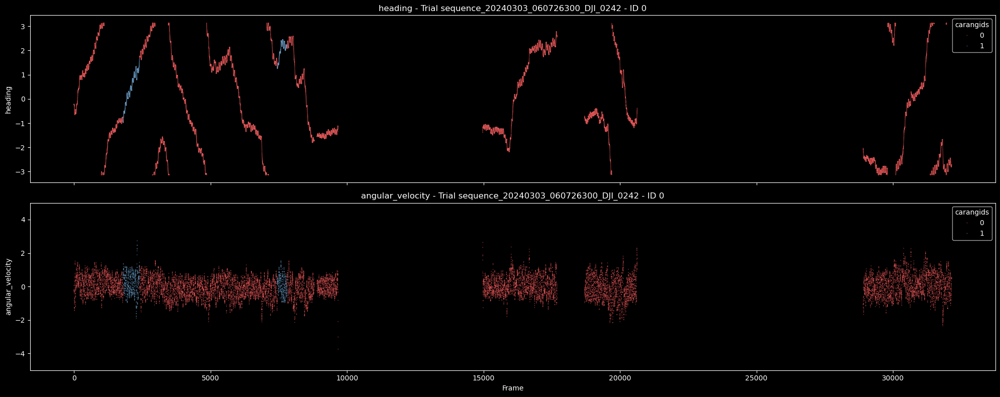

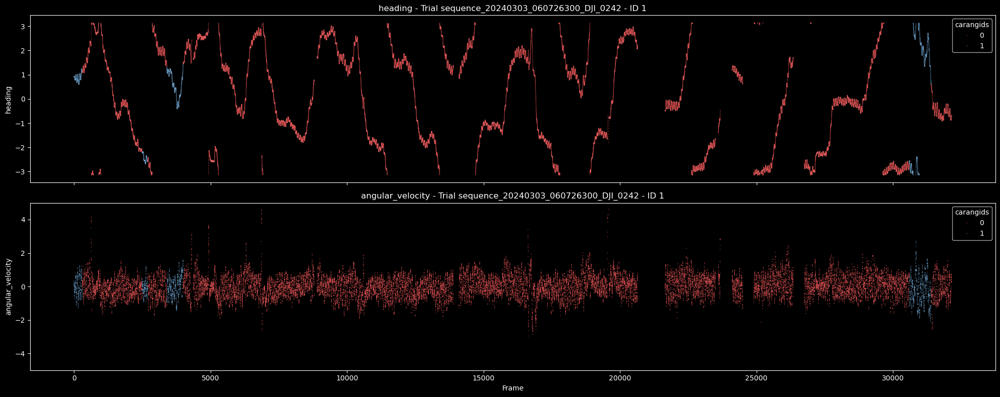

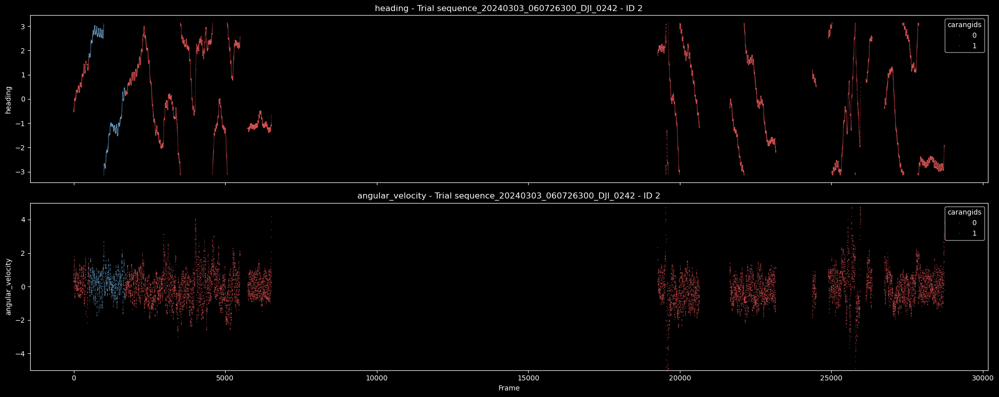

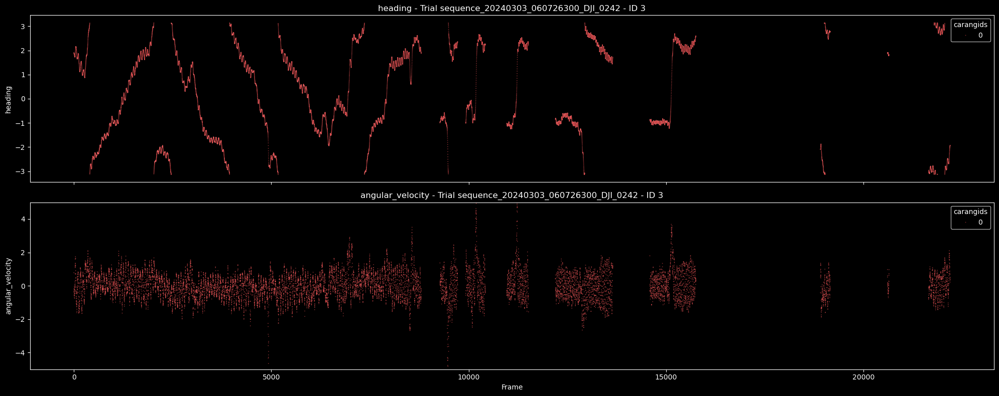

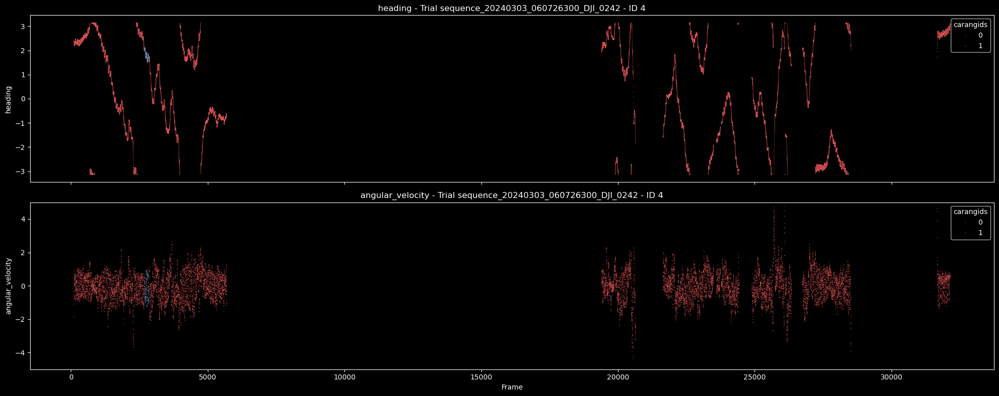

...

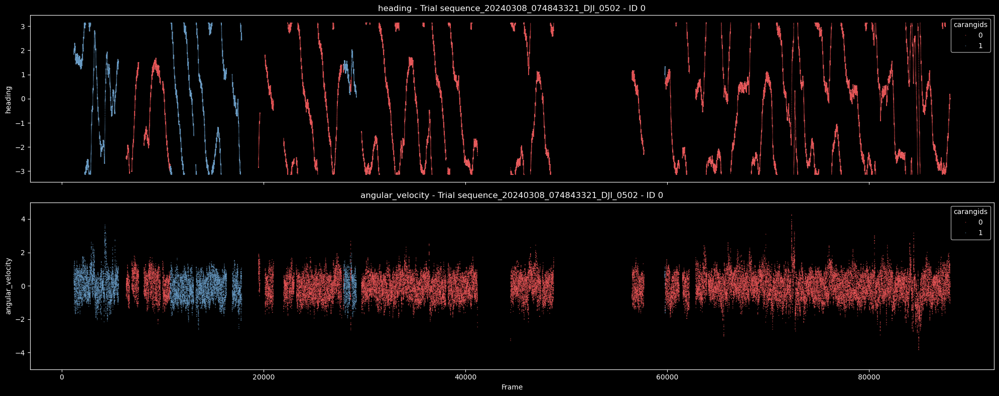

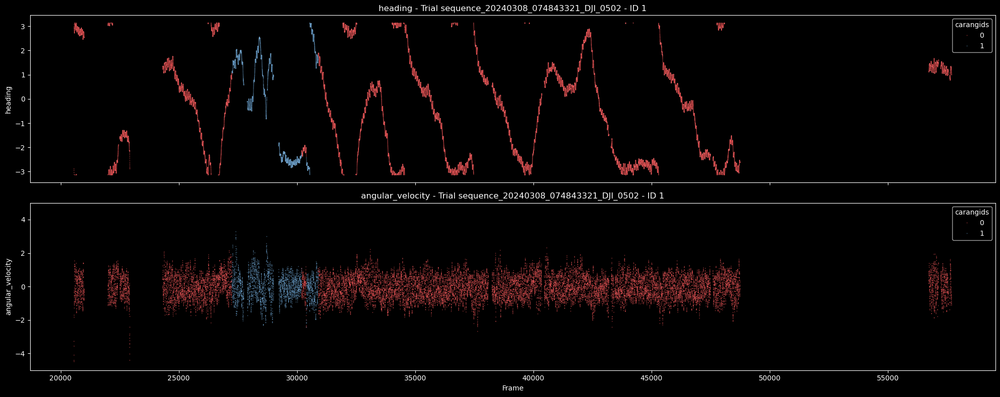

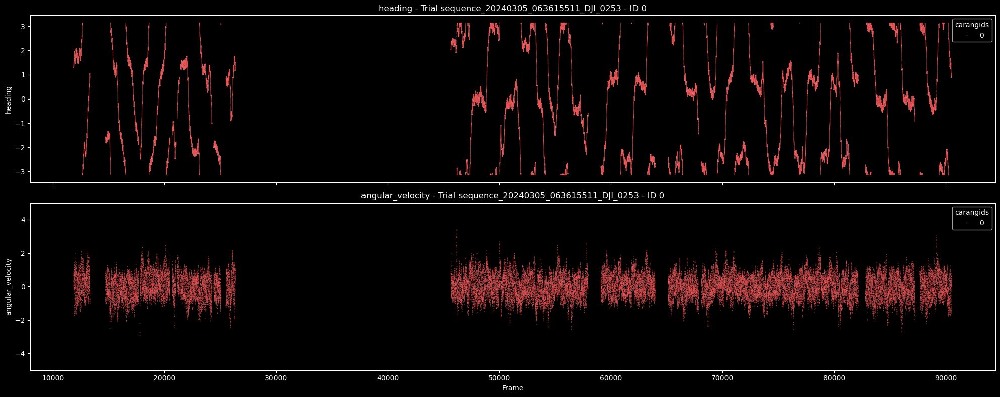

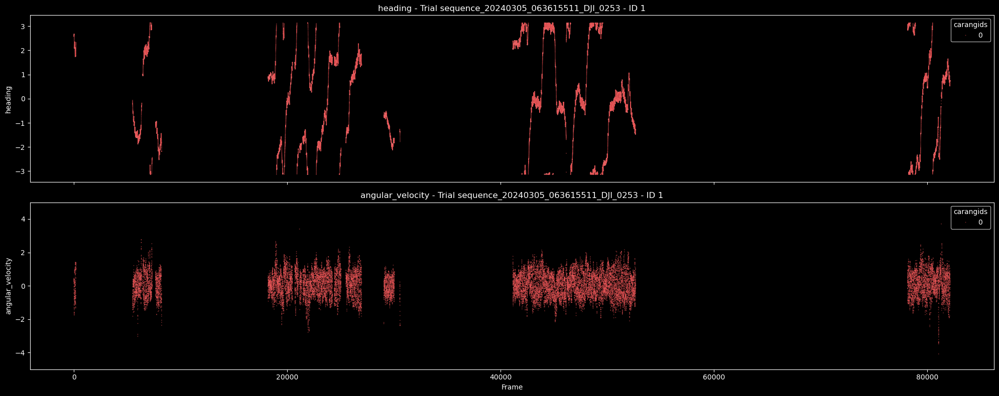

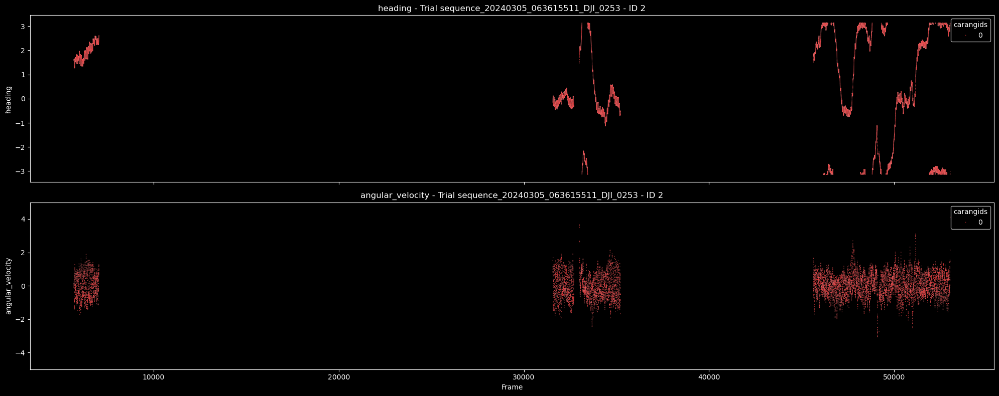

In [42]:
# Loop through each unique Trial
for trial in data['Trial'].unique():
    trial_data = data[data['Trial'] == trial]  # Filter data for the current trial
    
    # Loop through each unique ID in the current trial
    for i in trial_data['ID'].unique():
        # Create subplots for frequency and amplitude
        fig, axes = plt.subplots(2, 1, figsize=(20, 8), sharex=True)
        
        # Filter the data for the current ID and Trial
        fish_data = trial_data[trial_data['ID'] == i]
        
        # Plot for frequency
        sns.scatterplot(x='frame', y='heading', data=fish_data, hue='carangids', palette="Set1", s=1, alpha=0.7, ax=axes[0])
        axes[0].set_xlabel('Frame')
        axes[0].set_ylabel('heading')
        axes[0].set_title(f"heading - Trial {trial} - ID {i}")
        
        sns.scatterplot(x='frame', y='angular_velocity', data=fish_data, hue='carangids', palette="Set1", s=1, alpha=0.7, ax=axes[1])
        axes[1].set_xlabel('Frame')
        axes[1].set_ylabel('angular_velocity')
        axes[1].set_title(f"angular_velocity - Trial {trial} - ID {i}")
        axes[1].set_ylim(-5, 5)

        # Show the plot
        plt.tight_layout()
        plt.show()

C:\Users\sophi\AppData\Local\Temp\ipykernel_26588\2074826755.py:35: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Carangid", y=metric, data=avg_df, palette=palette)
C:\Users\sophi\AppData\Local\Temp\ipykernel_26588\2074826755.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.stripplot(


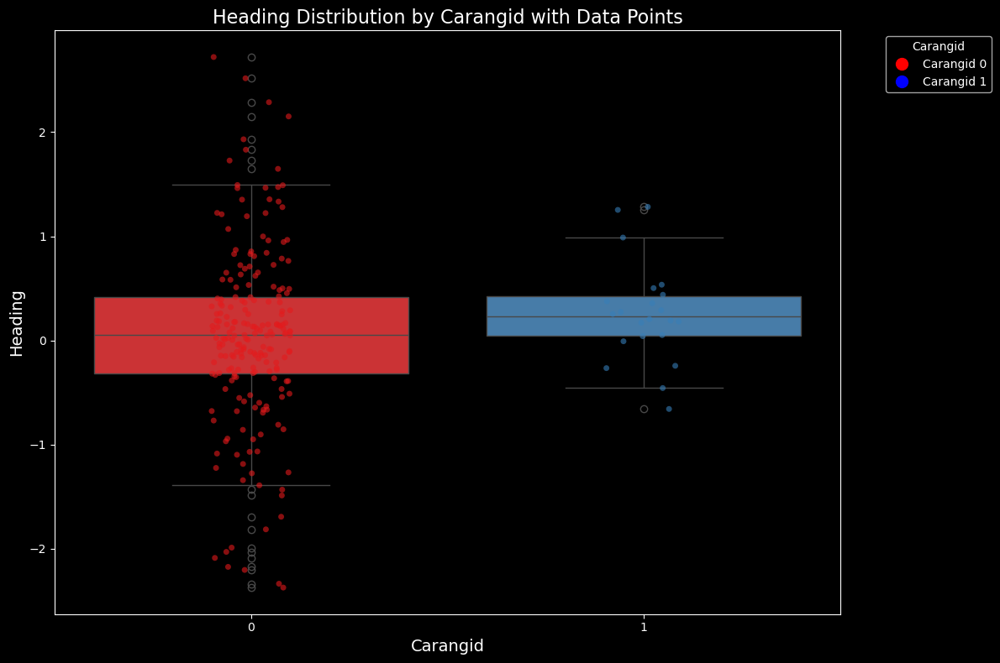

C:\Users\sophi\AppData\Local\Temp\ipykernel_26588\2074826755.py:35: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Carangid", y=metric, data=avg_df, palette=palette)
C:\Users\sophi\AppData\Local\Temp\ipykernel_26588\2074826755.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.stripplot(


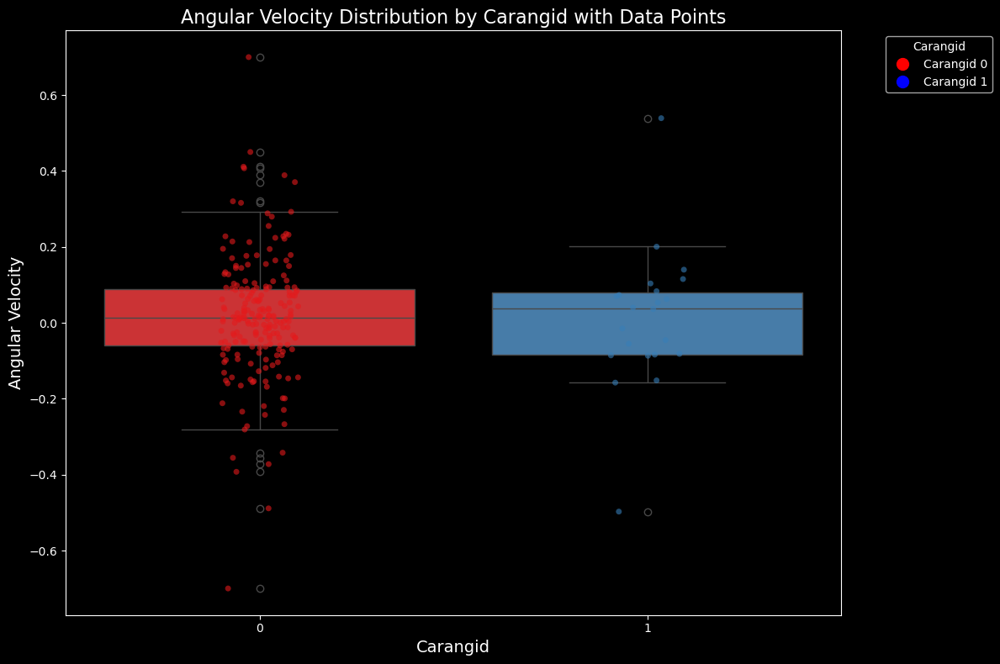

In [43]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Function to calculate averages for multiple metrics with filtering
def calculate_segment_averages(data, metrics, min_count=100):
    averages = []
    for trial, trial_data in data.groupby('Trial'):
        for id_, id_data in trial_data.groupby('ID'):
            for segment, segment_data in id_data.groupby('segment'):  # Group by 'segment'
                if len(segment_data) >= min_count:  # Filter by minimum count
                    avg_values = {metric: segment_data[metric].mean() for metric in metrics}
                    avg_values['Trial'] = trial  # Add Trial information
                    avg_values['Carangid'] = segment_data['carangids'].iloc[0]  # Add carangid info
                    averages.append(avg_values)  # Append average values for all metrics
    return pd.DataFrame(averages)

# Metrics to plot
metrics = ['heading','angular_velocity']

# Calculate the averages for the metrics
avg_df = calculate_segment_averages(data, metrics)

# Ensure 'Carangid' is treated as a categorical variable
avg_df['Carangid'] = avg_df['Carangid'].astype('category')

# Define color palette for carangid (0: red, 1: blue) with string keys to match the data
palette="Set1"

# Create plots for each metric
for metric in metrics:
    plt.figure(figsize=(12, 8))

    # Box plot for the current metric, with x as 'Carangid' and the specified color palette
    sns.boxplot(x="Carangid", y=metric, data=avg_df, palette=palette)

    # Overlay strip plot for data points with the same color palette
    sns.stripplot(
        x="Carangid", y=metric, data=avg_df, palette=palette, marker="o", alpha=0.6, jitter=True
    )

    # Add legend using Carangid values (0: red, 1: blue)
    handles = [
        plt.Line2D([0], [0], marker='o', color='red', linestyle='', markersize=10, label='Carangid 0'),
        plt.Line2D([0], [0], marker='o', color='blue', linestyle='', markersize=10, label='Carangid 1')
    ]
    plt.legend(handles=handles, title='Carangid', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Title and labels
    plt.title(f'{metric.replace("_", " ").title()} Distribution by Carangid with Data Points', fontsize=16)
    plt.xlabel("Carangid", fontsize=14)
    plt.ylabel(metric.replace("_", " ").title(), fontsize=14)

    # Adjust layout for better readability
    plt.tight_layout()
    plt.show()

In [122]:
sharks_nn = pd.read_hdf(output_folder + "nn_sharks.h5", key='sharks')
sharks_nn.head()

,index,SPEED#wcentroid,ID,X#pcentroid,Y#pcentroid,ANGLE,frame,time,headx,heady,...,midpoint_y,carangids,drone_movement,ID_checked,smoothed_body_length,standardized_speed,nearest_neighbor,nn_distance,mean_body_length,normalized_nnd
0,2051,82.087409,0,606.844014,-396.939687,-0.435146,2051,40.91,3172.583333,1069.333333,...,1082.916667,1,0,1.0,109.851996,0.747255,1,696.033544,108.149438,6.435850
1,2052,76.964699,0,608.723694,-396.273295,-0.456252,2052,40.93,3174.333333,1068.916667,...,1083.125000,1,0,1.0,110.187803,0.698487,1,698.254526,108.313050,6.446633
2,2053,75.903308,0,610.451965,-395.569743,-0.479337,2053,40.95,3175.916667,1068.416667,...,1083.250000,1,0,1.0,110.539454,0.686663,1,700.389238,108.468860,6.457054
3,2054,71.775297,0,612.184855,-394.984894,-0.500498,2054,40.97,3177.416667,1067.916667,...,1083.333333,1,0,1.0,110.882277,0.647311,1,702.533543,108.648260,6.466128
4,2055,81.043147,0,613.870341,-394.378459,-0.521608,2055,40.99,3178.833333,1067.500000,...,1083.416667,1,0,1.0,111.196668,0.728827,1,704.553259,108.808531,6.475166


In [123]:
data = pd.merge(data, sharks_nn[['Trial', 'ID', 'frame', 'nearest_neighbor','nn_distance','normalized_nnd']], on=['Trial', 'ID', 'frame'], how='left')

### Autocorrelation

   ID  segment                                 Trial  lag  autocorrelation
0   0        1  sequence_20240303_060726300_DJI_0242    0         1.000000
1   0        1  sequence_20240303_060726300_DJI_0242    1         0.946573
2   0        1  sequence_20240303_060726300_DJI_0242    2         0.909062
3   0        1  sequence_20240303_060726300_DJI_0242    3         0.865527
4   0        1  sequence_20240303_060726300_DJI_0242    4         0.816848


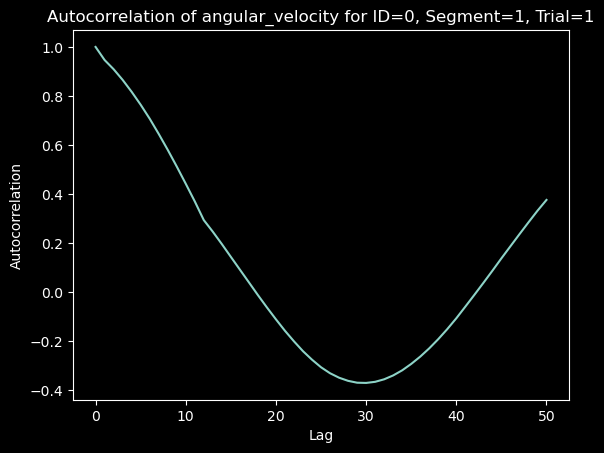

In [38]:

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from joblib import Parallel, delayed

def autocorrelation(x, max_lag=30):
    """
    Calculate autocorrelation for a time series up to a maximum lag.
    
    Parameters:
    - x: A pandas Series or numpy array containing the speed values.
    - max_lag: The maximum number of lags to compute autocorrelation for.
    
    Returns:
    - A numpy array containing autocorrelation values for lags 0 to max_lag.
    """
    autocorr_values = []
    for lag in range(max_lag + 1):
        # Compute the autocorrelation at lag 'lag'
        autocorr = np.corrcoef(x[:-lag] if lag != 0 else x, x[lag:])[0, 1] if lag != 0 else 1
        autocorr_values.append(autocorr)
    return np.array(autocorr_values)

def calculate_autocorrelation_for_group(group, col, max_lag):
    """
    Calculate autocorrelation for a single group (ID, segment, Trial).
    
    Parameters:
    - group: A pandas DataFrame for a specific group (ID, segment, Trial).
    - col: The column name containing the values.
    - max_lag: The maximum number of lags for autocorrelation.
    
    Returns:
    - A DataFrame with autocorrelation values for the group.
    """
    # Extract the speed values for the group
    values = group[col].dropna().values
    
    if len(values) > max_lag:
        # Calculate autocorrelation for this group
        autocorr = autocorrelation(values, max_lag)
        
        # Create a DataFrame with the autocorrelation results
        autocorr_results = {
            'ID': group['ID'].iloc[0],
            'segment': group['segment'].iloc[0],
            'Trial': group['Trial'].iloc[0],
            'lag': np.arange(len(autocorr)),
            'autocorrelation': autocorr
        }
        
        return pd.DataFrame(autocorr_results)
    return pd.DataFrame()

def calculate_autocorrelation_per_id_segment(df, col, max_lag=30, n_jobs=-1):
    """
    Calculate autocorrelation for speed for each unique ID, segment, and Trial.
    
    Parameters:
    - df: A pandas DataFrame containing columns for speed, ID, segment, and Trial.
    - col: The column name containing the values.
    - max_lag: The maximum lag for autocorrelation.
    - n_jobs: The number of jobs to run in parallel. If -1, use all available cores.
    
    Returns:
    - DataFrame: The original DataFrame with a new 'autocorrelation' column.
    """
    # Group by ID, Trial, and segment
    grouped = df.groupby(['ID', 'segment', 'Trial'])
    
    # Use Parallel processing to speed up the autocorrelation calculation
    autocorr_results = Parallel(n_jobs=n_jobs)(
        delayed(calculate_autocorrelation_for_group)(group, col, max_lag)
        for _, group in grouped
    )
    
    # Concatenate all results into a single DataFrame
    autocorr_df = pd.concat(autocorr_results, ignore_index=True)
    
    return autocorr_df


# Calculate the autocorrelation for speed with a maximum lag of 50
autocorr_df = calculate_autocorrelation_per_id_segment(data, col='angular_velocity', max_lag=50)

# View the result (sample output for first few rows)
print(autocorr_df.head())

# Optionally, plot the autocorrelation for a specific group
group = data[(data['ID'] == 0) & (data['segment'] == 1) & (data['Trial'] == 'sequence_20240303_060726300_DJI_0242')]
autocorr_values = autocorrelation(group['angular_velocity'].dropna().values, max_lag=50)

plt.plot(range(len(autocorr_values)), autocorr_values)
plt.title("Autocorrelation of angular_velocity for ID=0, Segment=1, Trial=1")
plt.xlabel("Lag")
plt.ylabel("Autocorrelation")
plt.show()

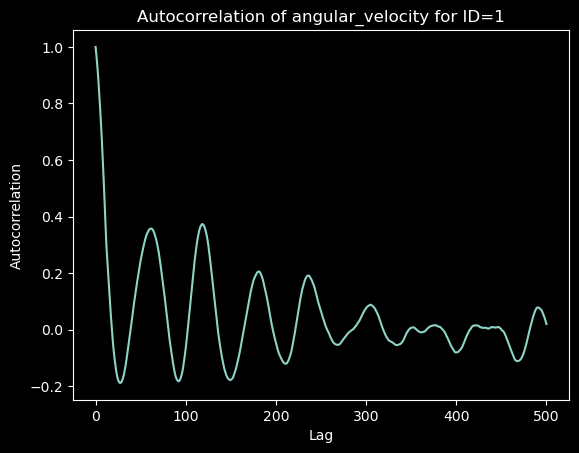

In [39]:
# Optionally, plot the autocorrelation for a specific group
group = data[(data['ID'] == 1) & (data['segment'] == 2) & (data['Trial'] == 'sequence_20240303_060726300_DJI_0242')]
autocorr_values = autocorrelation(group['angular_velocity'].dropna().values, max_lag=500)

plt.plot(range(len(autocorr_values)), autocorr_values)
plt.title("Autocorrelation of angular_velocity for ID=1")
plt.xlabel("Lag")
plt.ylabel("Autocorrelation")
plt.show()

### Accerleration

In [16]:
data = pd.merge(data, sharks_speed[['Trial', 'ID', 'frame', 'smoothed_body_length','standardized_speed']], on=['Trial', 'ID', 'frame'], how='left')

In [27]:
# Ensure heading is in radians for trigonometric calculations
data['heading_rad'] = np.radians(data['heading'])

# Initialize acceleration columns
data['linear_acceleration'] = np.nan
data['directional_acceleration'] = np.nan

# Define window size and overlap
window_size = 100  # 1 second
step_size = 20    # 50% overlap

# Loop through each trial and ID
for trial, trial_data in data.groupby('Trial'):
    for fish_id, fish_data in trial_data.groupby('ID'):
        # Sort by frame for correct calculations
        fish_data = fish_data.sort_values(by='frame')

        # Calculate speed components
        fish_data['vx'] = fish_data['standardized_speed'] * np.cos(fish_data['heading_rad'])
        fish_data['vy'] = fish_data['standardized_speed'] * np.sin(fish_data['heading_rad'])

        # Loop through sliding windows
        for start in range(0, len(fish_data), step_size):
            end = min(start + window_size, len(fish_data))  # Adjust window size for the last frames
            window = fish_data.iloc[start:end]

            # Check if there's enough data for calculations
            if len(window) < 2:
                continue

            # Calculate linear acceleration (rate of change of speed)
            linear_acceleration = window['standardized_speed'].diff().mean() / (window['frame'].diff().mean())

            # Calculate acceleration components
            ax = window['vx'].diff().mean() / (window['frame'].diff().mean())
            ay = window['vy'].diff().mean() / (window['frame'].diff().mean())

            # Calculate directional acceleration (magnitude of vector acceleration)
            directional_acceleration = np.sqrt(ax**2 + ay**2)

            # Assign mean values back to the central frame of the window
            center_idx = window.index[len(window) // 2]
            data.loc[center_idx, 'linear_acceleration'] = linear_acceleration
            data.loc[center_idx, 'directional_acceleration'] = directional_acceleration

        # Fill the initial frames with the first calculated value (optional)
        first_valid_index = fish_data['linear_acceleration'].first_valid_index()
        if first_valid_index is not None:
            data.loc[fish_data.index[:first_valid_index], 'linear_acceleration'] = data.loc[first_valid_index, 'linear_acceleration']
            data.loc[fish_data.index[:first_valid_index], 'directional_acceleration'] = data.loc[first_valid_index, 'directional_acceleration']

# Display the updated DataFrame with accelerations
print(data[['Trial', 'ID', 'frame', 'standardized_speed', 'linear_acceleration', 'directional_acceleration']].head())



                                  Trial  ID  frame  standardized_speed  \
0  sequence_20240306_161443984_DJI_0139   0   2051            0.747255   
1  sequence_20240306_161443984_DJI_0139   0   2052            0.698487   
2  sequence_20240306_161443984_DJI_0139   0   2053            0.686663   
3  sequence_20240306_161443984_DJI_0139   0   2054            0.647311   
4  sequence_20240306_161443984_DJI_0139   0   2055            0.728827   

   linear_acceleration  directional_acceleration  
0                  NaN                       NaN  
1                  NaN                       NaN  
2                  NaN                       NaN  
3                  NaN                       NaN  
4                  NaN                       NaN  


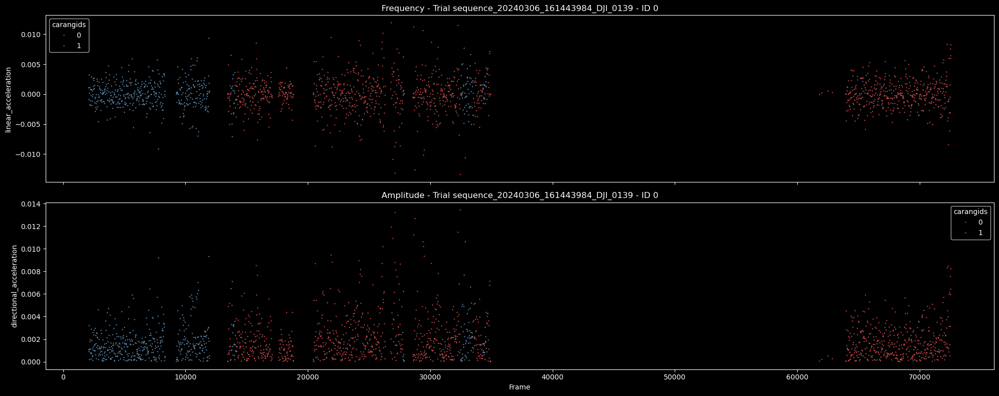

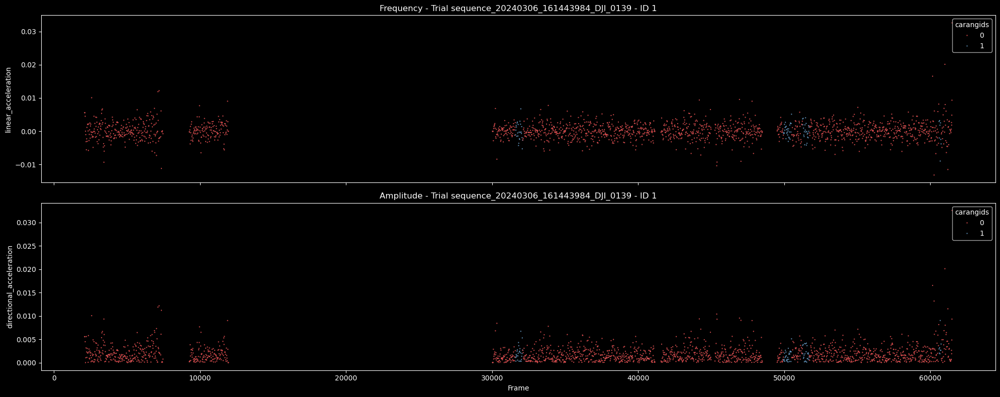

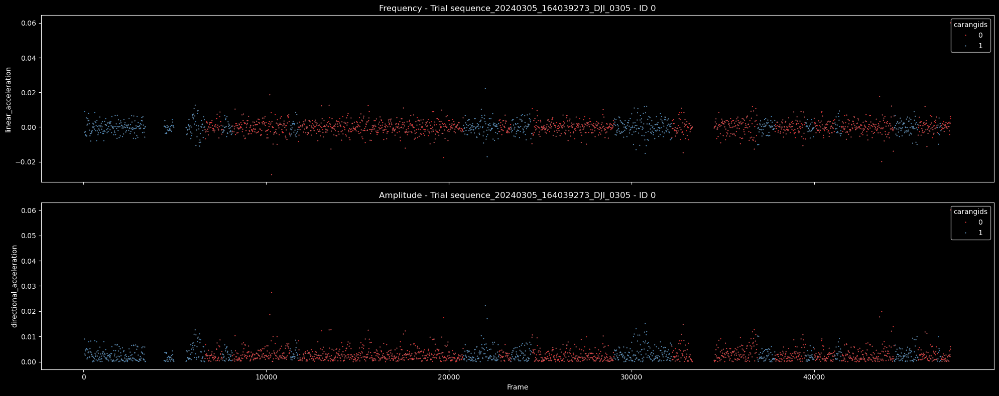

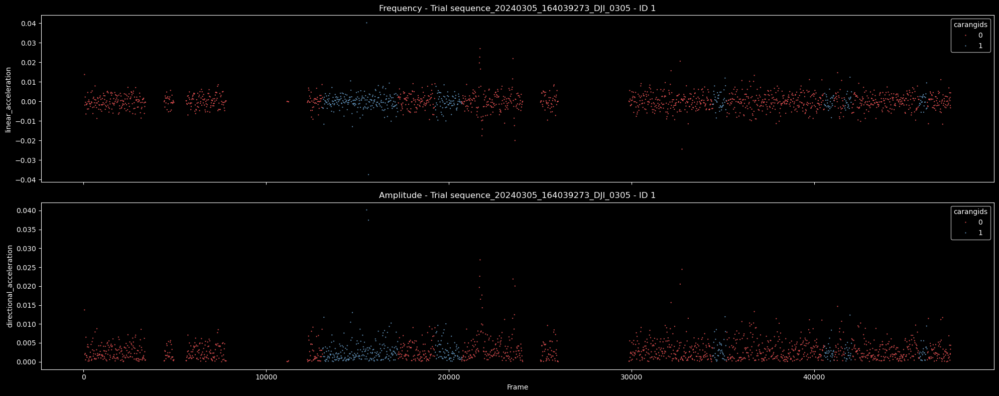

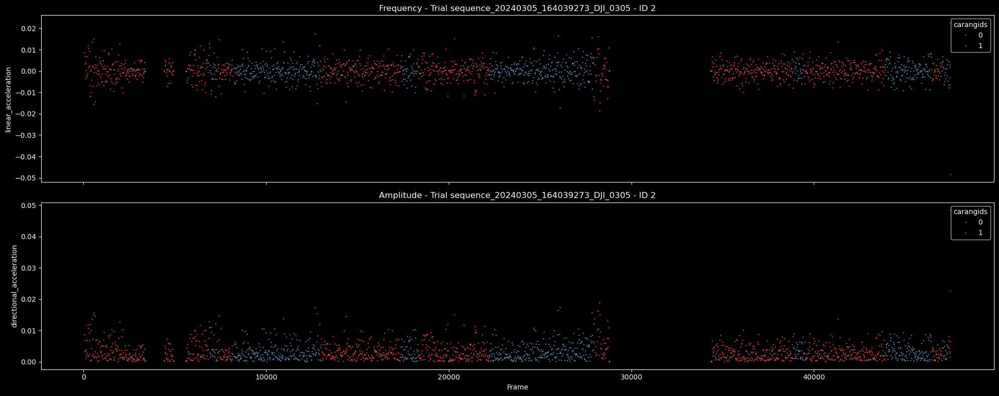

...

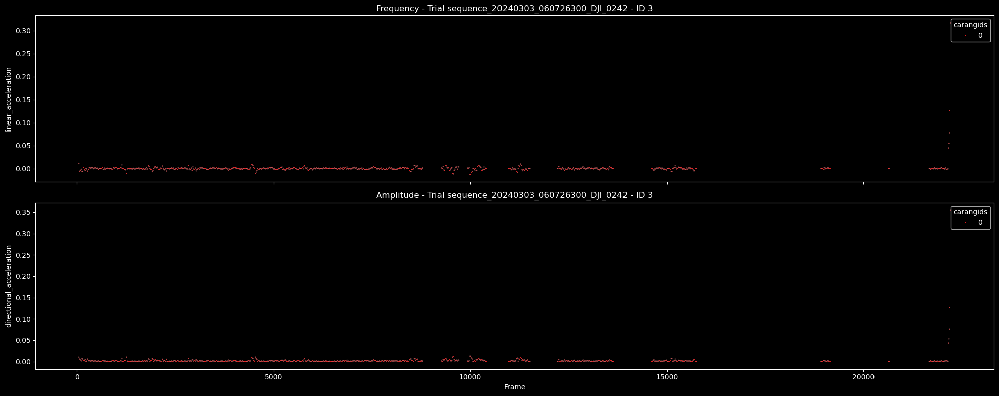

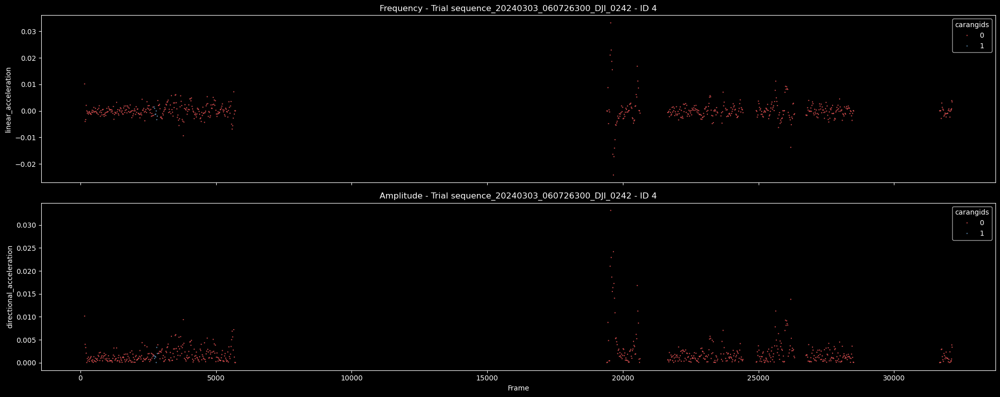

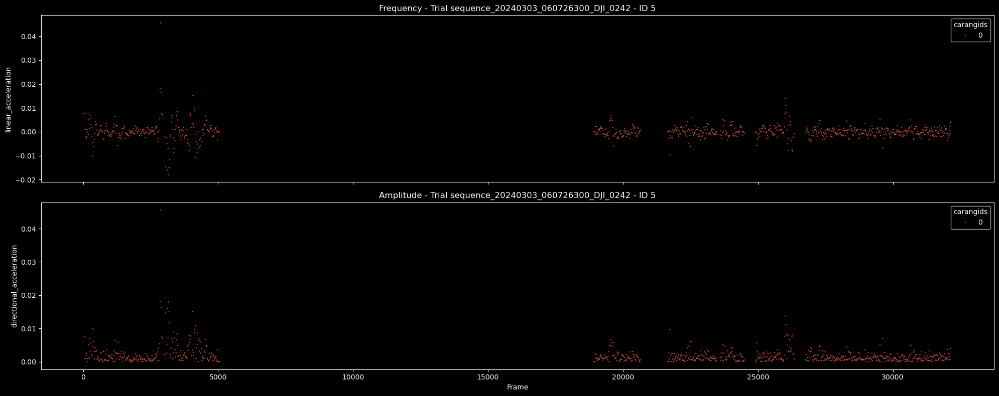

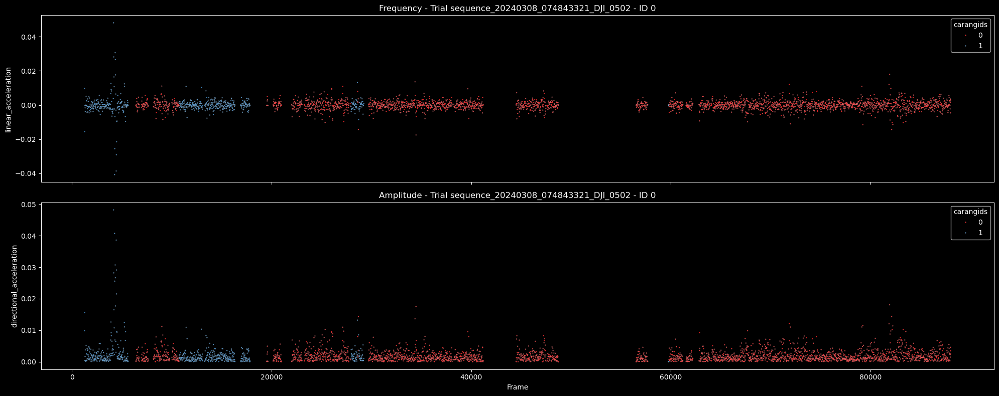

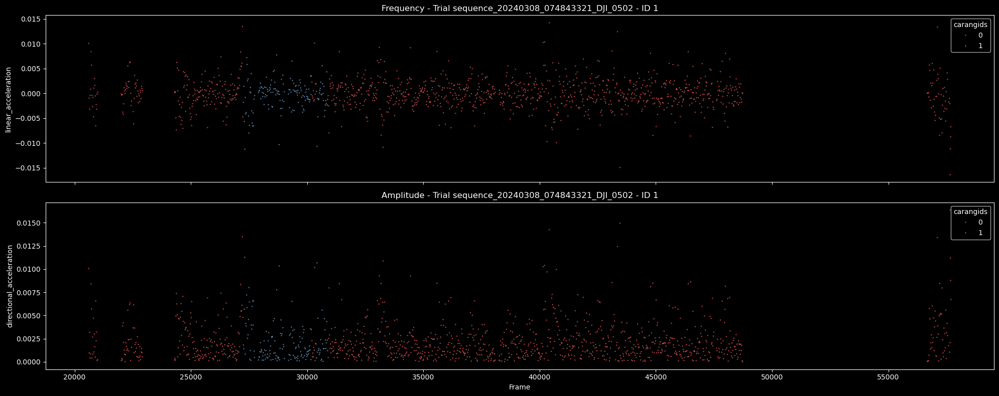

In [28]:
# Loop through each unique Trial
for trial in data['Trial'].unique():
    trial_data = data[data['Trial'] == trial]  # Filter data for the current trial
    
    # Loop through each unique ID in the current trial
    for i in trial_data['ID'].unique():
        # Create subplots for frequency and amplitude
        fig, axes = plt.subplots(2, 1, figsize=(20, 8), sharex=True)
        
        # Filter the data for the current ID and Trial
        fish_data = trial_data[trial_data['ID'] == i]
        
        # Plot for frequency
        sns.scatterplot(x='frame', y='linear_acceleration', data=fish_data, hue='carangids', palette="Set1", s=2, ax=axes[0])
        axes[0].set_xlabel('Frame')
        axes[0].set_ylabel('linear_acceleration')
        axes[0].set_title(f"Frequency - Trial {trial} - ID {i}")
        
        # Plot for amplitude
        sns.scatterplot(x='frame', y='directional_acceleration', data=fish_data, hue='carangids', palette="Set1", s=2, ax=axes[1])
        axes[1].set_xlabel('Frame')
        axes[1].set_ylabel('directional_acceleration')
        axes[1].set_title(f"Amplitude - Trial {trial} - ID {i}")

        # Show the plot
        plt.tight_layout()
        plt.show()

### Stuff

In [22]:
import numpy as np
from scipy.signal import find_peaks
import pandas as pd

# Use one coordinate (e.g., rotated_ttipy) for analysis
tail_y = onefish['rotated_ttipy']

# Detect peaks in the y-coordinate data with a minimum prominence
peaks, _ = find_peaks(tail_y, prominence=0)

# Assume a frame rate
frame_rate = 50  # Adjust based on your data

# Initialize array to store frequency values for all frames
frequencies_per_frame = np.zeros(len(onefish))

# Sliding window approach with overlapping windows
window_size = 100  # Number of frames in each window
step_size = 10     # Overlap of 50% between consecutive windows

for start in range(0, len(tail_y)):
    end = start + window_size
    window_peaks, _ = find_peaks(tail_y[start:end], prominence=5)
    
    # Get frame intervals in the window
    if len(window_peaks) > 1:
        frame_intervals = np.diff(window_peaks)
        # Calculate tail beat frequency for the current window
        frequency = frame_rate / np.mean(frame_intervals)
    else:
        frequency = 0  # If insufficient peaks, frequency is 0
    
    # Assign this frequency to the frames in the window
    frequencies_per_frame[start:end] += frequency

    # Normalize to account for overlapping contributions
    frequencies_per_frame[start:end] /= np.ceil(window_size / step_size)

# Add the frequency values to the DataFrame
onefish['tailbeat_frequency'] = frequencies_per_frame

# Display the updated DataFrame
print(onefish.head())



KeyError: 26

In [51]:
# import pandas as pd
# import numpy as np
# from scipy.signal import find_peaks

# # Use one coordinate (e.g., rotated_ttipy) for analysis
# tail_y = onefish['rotated_ttipy']

# # Detect peaks in the y-coordinate data
# peaks, _ = find_peaks(tail_y)
# troughs, _ = find_peaks(-np.array(tail_y))

# # Extract frame numbers corresponding to the peaks
# peak_frames = data2.iloc[peaks].index

# # Calculate frame intervals (time between peaks in frames)
# frame_intervals = np.diff(peak_frames)

# # Assume a frame rate 
# frame_rate = 50  # Adjust based on your data

# # Convert frame intervals to time intervals (seconds)
# time_intervals = frame_intervals / frame_rate

# # Calculate the average period (seconds per cycle)
# average_period = np.mean(time_intervals)

# # Calculate the tailbeat frequency (Hz)
# frequency = 1 / average_period

# print(f"Tailbeat Frequency: {frequency:.2f} Hz")


KeyboardInterrupt: 

In [52]:

from scipy.signal import find_peaks

# Assuming 'data2' is your DataFrame

# Parameters
frame_rate = 50  # Frames per second
window_size = 100  # Number of frames in each window
step_size = 10     # Step size for the sliding window (for calculating frequency)

# Initialize lists to store frequencies and amplitudes for each combination of Trial, ID, and frame
frequency_list = []
amplitude_list = []

# Iterate through each unique trial
for trial in data2['Trial'].unique():
    trial_data = data2[data2['Trial'] == trial]  # Filter data for the current trial
    
    # Iterate through each unique ID in the trial
    for fish_id in trial_data['ID'].unique():
        onefish = trial_data[trial_data['ID'] == fish_id]  # Filter data for the current fish ID
        
        tail_y = onefish['rotated_ttipy']  # Use one coordinate (e.g., rotated_ttipy) for analysis
        total_frames = len(tail_y)

        # Initialize arrays to store frequencies and amplitudes for each frame
        frequencies = np.full(total_frames, np.nan)  # Initialize with NaNs
        amplitudes = np.full(total_frames, np.nan)   # Initialize with NaNs

        # Iterate over the data using a sliding window to calculate frequency and amplitude for each window
        for start in range(0, total_frames - window_size, step_size):
            # Define the current window
            window = tail_y[start:start + window_size]
            
            # Detect peaks in the current window (both positive and negative peaks)
            peaks, _ = find_peaks(window)
            troughs, _ = find_peaks(-window)  # Negative of the signal to find troughs
            
            # Combine the peaks and troughs to find full oscillations
            all_peaks = np.sort(np.concatenate([peaks, troughs]))  # Sort both peaks and troughs
            
            # Check if enough peaks are detected to calculate frequency
            if len(all_peaks) > 1:
                # Calculate time intervals between consecutive peaks (frames)
                frame_intervals = np.diff(all_peaks)
                
                # Convert frame intervals to time intervals (seconds)
                time_intervals = frame_intervals / frame_rate
                
                # Calculate the average period in this window (seconds per cycle)
                average_period = np.mean(time_intervals)
                
                # Calculate the frequency (Hz)
                frequency = 1 / average_period
            else:
                # Not enough peaks to calculate frequency
                frequency = np.nan
            
            # Calculate the amplitude as the difference between the max and min values in the window
            amplitude = np.max(window) - np.min(window)
            
            # Assign the calculated frequency and amplitude to all frames within the current window
            frequencies[start:start + window_size] = frequency
            amplitudes[start:start + window_size] = amplitude

        # Now, we need to add the calculated frequency and amplitude for each frame, Trial, and ID
        for idx, frame in enumerate(onefish['frame']):
            frequency_list.append({
                'Trial': trial,
                'ID': fish_id,
                'frame': frame,
                'frequency': frequencies[idx]
            })
            amplitude_list.append({
                'Trial': trial,
                'ID': fish_id,
                'frame': frame,
                'amplitude': amplitudes[idx]
            })

# Convert the lists into DataFrames
frequency_df = pd.DataFrame(frequency_list)
amplitude_df = pd.DataFrame(amplitude_list)

# Merge the frequency and amplitude DataFrames back into the original data2 DataFrame
data2 = pd.merge(data2, frequency_df[['Trial', 'ID', 'frame', 'frequency']], on=['Trial', 'ID', 'frame'], how='left')
data2 = pd.merge(data2, amplitude_df[['Trial', 'ID', 'frame', 'amplitude']], on=['Trial', 'ID', 'frame'], how='left')


KeyboardInterrupt: 

In [49]:
import pandas as pd
import numpy as np

# Parameters
window_size = 100  # Number of frames in each window
step_size = 10     # Step size for the sliding window (for calculating amplitude)

# Initialize a list to store amplitude values for each combination of Trial, ID, and frame
amplitude_list = []

# Iterate through each unique trial
for trial in data2['Trial'].unique():
    trial_data = data2[data2['Trial'] == trial]  # Filter data for the current trial
    
    # Get the unique fish IDs for the current trial
    for fish_id in trial_data['ID'].unique():
        fish_data = trial_data[trial_data['ID'] == fish_id]
        
        total_frames = len(fish_data)  # Total number of frames for this fish trial
        
        # Initialize an array to store amplitude for the current trial and fish
        amplitudes = np.full(total_frames, np.nan)
        
        # Iterate over the data using a sliding window to calculate amplitude for each window
        for start in range(0, total_frames - window_size, step_size):
            # Define the current window
            window = fish_data['rotated_ttipy'][start:start + window_size]
            
            # Calculate the amplitude as the difference between the max and min values in the window
            amplitude = np.max(window) - np.min(window)
            
            # Standardize the amplitude with the smoothed body length for the whole window
            if isinstance(smoothed_body_length, (np.ndarray, pd.Series)):
                if len(smoothed_body_length) == len(window):
                    standardized_amplitude = amplitude / smoothed_body_length[start]  # Use the body length at this frame
                else:
                    standardized_amplitude = np.nan  # Handle case where lengths don't match
            else:
                standardized_amplitude = amplitude / smoothed_body_length  # Use the scalar directly
            
            # Assign the calculated amplitude to all frames within the current window
            amplitudes[start:start + window_size] = standardized_amplitude
        
        # Now, we need to add the calculated amplitude for each frame, Trial, and ID
        for idx, frame in enumerate(fish_data['frame']):
            amplitude_list.append({
                'Trial': trial,
                'ID': fish_id,
                'frame': frame,
                'amplitude': amplitudes[idx]
            })
    
    # Periodically save the intermediate results to avoid memory overload
    if len(amplitude_list) > 100000:  # Adjust chunk size as needed
        temp_df = pd.DataFrame(amplitude_list)
        temp_df.to_csv(f"amplitude_results_chunk_{trial}.csv", index=False)
        amplitude_list.clear()  # Clear the list after saving

# Save the final amplitude results if there are remaining data
if amplitude_list:
    final_df = pd.DataFrame(amplitude_list)
    final_df.to_csv("final_amplitude_results.csv", index=False)

print("Amplitude calculation complete!")



Amplitude calculation complete!


In [ ]:
import pandas as pd
import numpy as np

# Assuming 'data2' is your DataFrame and 'smoothed_body_length' is defined

# Parameters
window_size = 100  # Number of frames in each window
step_size = 10     # Step size for the sliding window (for calculating amplitude)

# Initialize a list to store amplitude values for each combination of Trial, ID, and frame
amplitude_list = []

# Iterate through each unique trial
for trial in data2['Trial'].unique():
    trial_data = data2[data2['Trial'] == trial]  # Filter data for the current trial
    
    # Get the unique fish IDs for the current trial
    for fish_id in trial_data['ID'].unique():
        fish_data = trial_data[trial_data['ID'] == fish_id]
        
        total_frames = len(fish_data)  # Total number of frames for this fish trial
        
        # Initialize an array to store amplitude for the current trial and fish
        amplitudes = np.full(total_frames, np.nan)
        
        # Iterate over the data using a sliding window to calculate amplitude for each window
        for start in range(0, total_frames - window_size, step_size):
            # Define the current window
            window = fish_data['rotated_ttipy'][start:start + window_size]
            
            # Calculate the amplitude as the difference between the max and min values in the window
            amplitude = np.max(window) - np.min(window)
            
            # --- Insert the fix for smoothed_body_length here ---
            # Assuming smoothed_body_length is a list, numpy array, or scalar that corresponds to the window
            if isinstance(smoothed_body_length, (np.ndarray, pd.Series)):
                # Ensure smoothed_body_length has the same length as the data you're processing
                if len(smoothed_body_length) == len(window):
                    # Standardize the amplitude with the smoothed body length for the whole window
                    standardized_amplitude = amplitude / smoothed_body_length[start]  # Use the body length at this frame
                else:
                    standardized_amplitude = np.nan  # Handle case where lengths don't match
            else:
                # If smoothed_body_length is a scalar
                standardized_amplitude = amplitude / smoothed_body_length  # Use the scalar directly
            
            # Assign the calculated amplitude to all frames within the current window
            amplitudes[start:start + window_size] = standardized_amplitude
        
        # Now, we need to add the calculated amplitude for each frame, Trial, and ID
        for idx, frame in enumerate(fish_data['frame']):
            amplitude_list.append({
                'Trial': trial,
                'ID': fish_id,
                'frame': frame,
                'amplitude': amplitudes[idx]
            })

# Convert the list into a DataFrame
amplitude_df = pd.DataFrame(amplitude_list)


In [ ]:
# Merge the frequency and amplitude DataFrames back into the original data2 DataFrame
data2 = pd.merge(data2, frequency_df[['Trial', 'ID', 'frame', 'frequency']], on=['Trial', 'ID', 'frame'], how='left')
data2 = pd.merge(data2, amplitude_df[['Trial', 'ID', 'frame', 'amplitude']], on=['Trial', 'ID', 'frame'], how='left')

# Optional: Print the first few rows to check the results
print(data2.head())

In [22]:
import pandas as pd

# Function to calculate the Strouhal number
def calculate_strouhal_number(speed_bl, amplitude, frequency):
    if speed_bl == 0:
        return None  # Or return some default value like 0 or np.nan depending on your needs
    return (frequency * amplitude) / speed_bl

def process_dataframe(data):
    # Check if required columns are present
    required_columns = {'standardized_speed', 'amplitude', 'frequency'}
    if not required_columns.issubset(data.columns):
        raise ValueError(f"DataFrame is missing required columns: {required_columns - set(data.columns)}")

    # Calculate Strouhal number for each row
    data['Strouhal_number'] = data.apply(
        lambda row: calculate_strouhal_number(
            row['standardized_speed'],
            row['amplitude'],
            row['frequency']
        ), axis=1
    )
    return data

if __name__ == "__main__":
    try:
        # Process the preloaded data2 DataFrame
        processed_data2 = process_dataframe(data2)

        # Output the processed DataFrame
        print("Processed DataFrame:")
        print(processed_data2.head())

    except ValueError as e:
        print(f"Error: {e}")

Processed DataFrame:
   index  SPEED#wcentroid  ID  X#pcentroid  Y#pcentroid     ANGLE  frame  \
0   2051        82.087409   0   606.844014  -396.939687 -0.435146   2051   
1   2052        76.964699   0   608.723694  -396.273295 -0.456252   2052   
2   2053        75.903308   0   610.451965  -395.569743 -0.479337   2053   
3   2054        71.775297   0   612.184855  -394.984894 -0.500498   2054   
4   2055        81.043147   0   613.870341  -394.378459 -0.521608   2055   

    time        headx        heady  ...  rotated_peduncley  rotated_finx  \
0  40.91  3172.583333  1069.333333  ...         -12.477312    -66.073748   
1  40.93  3174.333333  1068.916667  ...         -13.535417    -65.766696   
2  40.95  3175.916667  1068.416667  ...         -14.470517    -65.406591   
3  40.97  3177.416667  1067.916667  ...         -15.289182    -65.062902   
4  40.99  3178.833333  1067.500000  ...         -15.870505    -64.625645   

   rotated_finy  rotated_ttipx  rotated_ttipy  smoothed_body_leng

In [33]:
# Filter the DataFrame based on frame column
subset_df = data2[(data2['frame'] >= frame_start) & (data2['frame'] <= frame_end)]

subset_df.head()

,index,SPEED#wcentroid,ID,X#pcentroid,Y#pcentroid,ANGLE,frame,time,headx,heady,...,rotated_finx,rotated_finy,rotated_ttipx,rotated_ttipy,smoothed_body_length,standardized_speed,frequency,amplitude,Strouhal_number,Trial_num
112193,37776,102.756644,0,NaN,NaN,0.917489,38986,779.609996,1697.083333,1404.750000,...,-84.920215,23.662149,-100.021391,32.011487,137.494594,0.747350,1.785714,0.692882,1.655568,6
112194,37777,106.664377,0,NaN,NaN,0.926953,38987,779.629995,1698.333333,1406.083333,...,-84.947571,23.894198,-99.852125,32.366382,137.718345,0.774511,1.785714,0.692882,1.597510,6
112195,37778,109.087515,0,NaN,NaN,0.931817,38988,779.649994,1699.666667,1407.250000,...,-85.146713,23.455539,-100.036003,31.877362,137.918358,0.790957,1.666667,0.692882,1.460007,6
112196,37779,109.108221,0,NaN,NaN,0.933892,38989,779.669998,1701.083333,1408.416667,...,-85.319812,23.015209,-100.214210,31.276395,138.081047,0.790175,1.666667,0.692882,1.461452,6
112197,37780,109.063653,0,NaN,NaN,0.934764,38990,779.689997,1702.583333,1409.666667,...,-85.636416,22.380620,-100.595860,30.228109,138.208518,0.789124,1.666667,0.692882,1.463399,6
